In [1]:
import numpy as np
import matplotlib.pyplot as plt

class dual:
    def __init__(self, f,d):
        self.f = f
        self.d = d
    def __add__(self, other):
        return dual(self.f + other.f, self.d + other.d)
    def __sub__(self, other):
        return dual(self.f - other.f, self.d - other.d)
    def __neg__(self):
        return dual(-self.f, -self.d)
    def __mul__(self, other):
        return dual(self.f * other.f, self.f * other.d + self.d * other.f)
    def __truediv__(self, other):
        return dual(self.f / other.f, (self.d * other.f - self.f * other.d)/other.f**2)
    def __pow__(self, num):
        return dual(self.f**num, num*self.f**(num-1)*self.d)
    def sin(self):
        return dual(np.sin(self.f), np.cos(self.f)*self.d)
    def cos(self):
        return dual(np.cos(self.f), -np.sin(self.f)*self.d)
    def exp(self):
        return dual(np.exp(self.f), np.exp(self.f)*self.d)
    def log(self):
        return dual(np.log(self.f), self.d/self.f)
    def sqrt(self):
        return dual(np.sqrt(self.f), 1/2/np.sqrt(self.f) * self.d)
    def print(self):
        return [self.f, self.d]
    def plot( f, xmin, xmax):
        x = np.linspace(xmin,xmax,100)
        xfd = [dual(v,1) for v in x]
        yf = [f(v).f for v in xfd]; yd = [f(v).d for v in xfd]
        plt.plot(x, yf, label="f"); plt.plot(x, yd, label="d")
        plt.grid(); plt.legend(); plt.show()
        
sin = lambda x: x.sin(); cos = lambda x: x.cos()
exp = lambda x: x.exp(); log = lambda x: x.log()
sqrt = lambda x: x.sqrt()

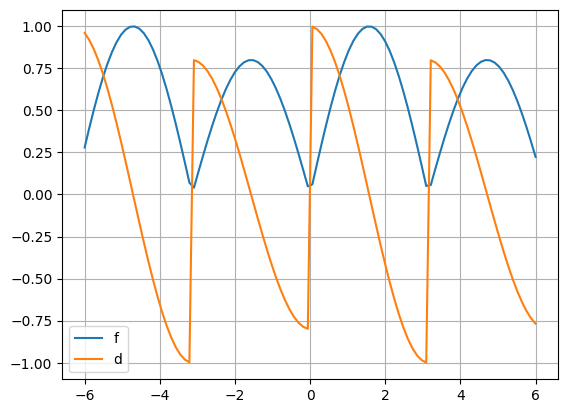

In [2]:
def f(x):
    if sin(x).f>0:
        return sin(x)
    else:
        return -sin(x)*dual(0.8,0)
dual.plot(f,-6,6)

In [3]:
# 1-d gradient descent
x = dual(1.0, 1)
gamma = 0.1
x0 = dual(1.0e99, 1)
i = 0
while abs(x.f - x0.f) > 1.0e-9:
    x0 = x
    x = x0 - dual(f(x0).d *gamma, 0)
    i += 1
    if i%10 == 0:
        print("[ i=", i, "] ", x.f)
print("[ i=", i, "] ", x.f)

[ i= 10 ]  0.2527834019443468
[ i= 20 ]  -0.0227859199736707
[ i= 30 ]  0.0572121575677421
[ i= 40 ]  -0.04260458132894074
[ i= 50 ]  0.03734325433598752
[ i= 60 ]  -0.06256577223115327
[ i= 70 ]  0.017299841572107746
[ i= 80 ]  -0.0826622047881118
[ i= 90 ]  -0.0029113843221649366
[ i= 100 ]  0.07711314451262812
[ i= 110 ]  -0.02256370668977531
[ i= 120 ]  0.05744290037567956
[ i= 130 ]  -0.04236404452451889
[ i= 140 ]  0.037593418975432155
[ i= 150 ]  -0.062305503441110466
[ i= 160 ]  0.017570958090515204
[ i= 170 ]  -0.08238070042423143
[ i= 180 ]  -0.0026176793934546416
[ i= 190 ]  0.07741763790996253
[ i= 200 ]  -0.02224566125533016
[ i= 210 ]  0.05777314639085998
[ i= 220 ]  -0.042019771416908935
[ i= 230 ]  0.0379514635189481
[ i= 240 ]  -0.061932986063870085
[ i= 250 ]  0.017958991634227206
[ i= 260 ]  -0.08197778584202833
[ i= 270 ]  -0.0021973137895913986
[ i= 280 ]  0.07785343147547742
[ i= 290 ]  -0.021790455275697437
[ i= 300 ]  0.058245799409727364
[ i= 310 ]  -0.04152702

[ i= 52660 ]  0.07974703208372069
[ i= 52670 ]  -0.019812277322125912
[ i= 52680 ]  0.06029958869316464
[ i= 52690 ]  -0.04011061391999171
[ i= 52700 ]  0.03993680620531069
[ i= 52710 ]  -0.059867148569779594
[ i= 52720 ]  0.0201106625001998
[ i= 52730 ]  -0.07974331041271902
[ i= 52740 ]  -0.0006061580689148
[ i= 52750 ]  0.07950284533783128
[ i= 52760 ]  -0.020067391326998515
[ i= 52770 ]  0.06003474254475981
[ i= 52780 ]  -0.03966181040841062
[ i= 52790 ]  0.04040347395923313
[ i= 52800 ]  -0.060111695594123576
[ i= 52810 ]  0.019855973689896722
[ i= 52820 ]  -0.0800078260836319
[ i= 52830 ]  -0.00014222704568359057
[ i= 52840 ]  0.07998372104043686
[ i= 52850 ]  -0.020284487467922316
[ i= 52860 ]  0.05980936013747526
[ i= 52870 ]  -0.0398968199794552
[ i= 52880 ]  0.04015911218654418
[ i= 52890 ]  -0.05963580363911765
[ i= 52900 ]  0.020351597028358245
[ i= 52910 ]  -0.0802282327046649
[ i= 52920 ]  -0.00037214182110704985
[ i= 52930 ]  0.07974541117477384
[ i= 52940 ]  -0.01981397

95870 ]  -0.019802996867228834
[ i= 95880 ]  0.059588573770302036
[ i= 95890 ]  -0.04012703208880984
[ i= 95900 ]  0.03991973419773828
[ i= 95910 ]  -0.05988491451085551
[ i= 95920 ]  0.020092159946026672
[ i= 95930 ]  -0.0797625270956471
[ i= 95940 ]  0.00011364913278739952
[ i= 95950 ]  0.07950907651493058
[ i= 95960 ]  -0.020060881383360138
[ i= 95970 ]  0.060041500901165
[ i= 95980 ]  -0.039654763288935455
[ i= 95990 ]  0.040410801445530595
[ i= 96000 ]  -0.060104070150773445
[ i= 96010 ]  0.019863915450197486
[ i= 96020 ]  -0.07999957800324137
[ i= 96030 ]  -0.00013362322933524462
[ i= 96040 ]  0.0799926389262822
[ i= 96050 ]  -0.020275170219658536
[ i= 96060 ]  0.059819033096271734
[ i= 96070 ]  -0.03988673395025705
[ i= 96080 ]  0.0401695996863895
[ i= 96090 ]  -0.05962488959059985
[ i= 96100 ]  0.02036296336839853
[ i= 96110 ]  -0.08021642793117871
[ i= 96120 ]  -0.00035982769629372413
[ i= 96130 ]  0.07975817505354048
[ i= 96140 ]  -0.019800635562797528
[ i= 96150 ]  0.0595910

[ i= 140890 ]  -0.03989528056834987
[ i= 140900 ]  0.04016071287390116
[ i= 140910 ]  -0.059634137849182534
[ i= 140920 ]  0.020353331851320586
[ i= 140930 ]  -0.08022643096533406
[ i= 140940 ]  -0.0003702623397293381
[ i= 140950 ]  0.07974735930209534
[ i= 140960 ]  -0.019811935456752194
[ i= 140970 ]  0.060299943596311245
[ i= 140980 ]  -0.04011024385020752
[ i= 140990 ]  0.03993719101252369
[ i= 141000 ]  -0.05986674812078542
[ i= 141010 ]  0.02011107955233843
[ i= 141020 ]  -0.07974287726352675
[ i= 141030 ]  -0.0006057062433168642
[ i= 141040 ]  0.07950331367510621
[ i= 141050 ]  -0.020066902037679454
[ i= 141060 ]  0.06003525050498451
[ i= 141070 ]  -0.03966128074482582
[ i= 141080 ]  0.040404024695419344
[ i= 141090 ]  -0.06011112246359024
[ i= 141100 ]  0.019856570595075312
[ i= 141110 ]  -0.0800072061555707
[ i= 141120 ]  -0.00014158038020824215
[ i= 141130 ]  0.0799843913116966
[ i= 141140 ]  -0.02028378718074078
[ i= 141150 ]  0.059810087160228426
[ i= 141160 ]  -0.039896061

[ i= 180470 ]  -0.02006218343763011
[ i= 180480 ]  0.06004014916213407
[ i= 180490 ]  -0.03965617278385354
[ i= 180500 ]  0.040409335874763294
[ i= 180510 ]  -0.06010559531639864
[ i= 180520 ]  0.01986232701838482
[ i= 180530 ]  -0.08000122770267937
[ i= 180540 ]  -0.00013534407910276158
[ i= 180550 ]  0.07999085525997493
[ i= 180560 ]  -0.020277033763109062
[ i= 180570 ]  0.05981709840773457
[ i= 180580 ]  -0.03988875125778285
[ i= 180590 ]  0.04016750208138467
[ i= 180600 ]  -0.05962707251053004
[ i= 180610 ]  0.02036068998640557
[ i= 180620 ]  -0.08021878900536893
[ i= 180630 ]  -0.0003622906449688712
[ i= 180640 ]  0.07975562215061517
[ i= 180650 ]  -0.019803302741697767
[ i= 180660 ]  0.05958825621415083
[ i= 180670 ]  -0.04012736319833063
[ i= 180680 ]  0.03991938990184195
[ i= 180690 ]  -0.05988527280118747
[ i= 180700 ]  0.020091786799951994
[ i= 180710 ]  -0.07976291464338121
[ i= 180720 ]  0.00011324487814480533
[ i= 180730 ]  0.07950865748349771
[ i= 180740 ]  -0.02006131916

[ i= 221360 ]  0.040172631908886064
[ i= 221370 ]  -0.05962173403909764
[ i= 221380 ]  0.019632563458646668
[ i= 221390 ]  -0.08023985070597024
[ i= 221400 ]  -0.00038426112633770104
[ i= 221410 ]  0.0797328492181444
[ i= 221420 ]  -0.019827095032738343
[ i= 221430 ]  0.06028420586749518
[ i= 221440 ]  -0.040126654111474286
[ i= 221450 ]  0.03992012722793997
[ i= 221460 ]  -0.05988450550532241
[ i= 221470 ]  0.020092585910086544
[ i= 221480 ]  -0.07976208469138758
[ i= 221490 ]  0.00011411060876596879
[ i= 221500 ]  0.07950955485930394
[ i= 221510 ]  -0.020060381638947827
[ i= 221520 ]  0.06004201971515949
[ i= 221530 ]  -0.03965422230747391
[ i= 221540 ]  0.040411363949546544
[ i= 221550 ]  -0.060103484773460045
[ i= 221560 ]  0.01986452510979883
[ i= 221570 ]  -0.07999894482830375
[ i= 221580 ]  -0.00013296274608665115
[ i= 221590 ]  0.07999332351922056
[ i= 221600 ]  -0.02027445496880728
[ i= 221610 ]  0.05981977565340074
[ i= 221620 ]  -0.039885959682846514
[ i= 221630 ]  0.0401704

[ i= 267560 ]  -0.08022776248379394
[ i= 267570 ]  -0.0003716513109635333
[ i= 267580 ]  0.07974591960027852
[ i= 267590 ]  -0.019813439602640023
[ i= 267600 ]  0.0602983820865023
[ i= 267610 ]  -0.04011187209038558
[ i= 267620 ]  0.039935497930234085
[ i= 267630 ]  -0.05986851002397374
[ i= 267640 ]  0.020109244598213907
[ i= 267650 ]  -0.07974478304164473
[ i= 267660 ]  -0.0006076941943570224
[ i= 267670 ]  0.07950125307553567
[ i= 267680 ]  -0.020069054822298135
[ i= 267690 ]  0.060033015571598736
[ i= 267700 ]  -0.03966361116888234
[ i= 267710 ]  0.04040160155554463
[ i= 267720 ]  -0.06011364413431075
[ i= 267730 ]  0.01985394432000563
[ i= 267740 ]  -0.08000993372688846
[ i= 267750 ]  -0.00014442559155267154
[ i= 267760 ]  0.07998144223888957
[ i= 267770 ]  -0.020286868317844403
[ i= 267780 ]  0.05980688839112158
[ i= 267790 ]  -0.03989939727678242
[ i= 267800 ]  0.040156432299454245
[ i= 267810 ]  -0.05963859252100856
[ i= 267820 ]  0.020348692570166443
[ i= 267830 ]  -0.08023124

[ i= 314390 ]  -0.020058355609462106
[ i= 314400 ]  0.06004412305501464
[ i= 314410 ]  -0.03965202909751958
[ i= 314420 ]  0.04041364441450816
[ i= 314430 ]  -0.06010111157680864
[ i= 314440 ]  0.019866996749742558
[ i= 314450 ]  -0.07999637785370346
[ i= 314460 ]  -0.00013028506034169773
[ i= 314470 ]  0.07999609894842082
[ i= 314480 ]  -0.020271555247919182
[ i= 314490 ]  0.0598227860770717
[ i= 314500 ]  -0.0398828207009637
[ i= 314510 ]  0.04017366869876865
[ i= 314520 ]  -0.0596206550798382
[ i= 314530 ]  0.019633687158121166
[ i= 314540 ]  -0.08023868369134356
[ i= 314550 ]  -0.0003830437558065697
[ i= 314560 ]  0.0797341110530881
[ i= 314570 ]  -0.01982577671712263
[ i= 314580 ]  0.06028557446155407
[ i= 314590 ]  -0.04012522703327516
[ i= 314600 ]  0.039921611139111066
[ i= 314610 ]  -0.05988296127809953
[ i= 314620 ]  0.020094194165211868
[ i= 314630 ]  -0.07976041436504243
[ i= 314640 ]  0.00011585294149082936
[ i= 314650 ]  0.07951136087959267
[ i= 314660 ]  -0.0200584948212

[ i= 359260 ]  0.01985829009846099
[ i= 359270 ]  -0.08000542033001005
[ i= 359280 ]  -0.00013971753241115437
[ i= 359290 ]  0.07998632216042012
[ i= 359300 ]  -0.020281769864963592
[ i= 359310 ]  0.05981218149287221
[ i= 359320 ]  -0.03989387814295768
[ i= 359330 ]  0.04016217112265241
[ i= 359340 ]  -0.059632620290831787
[ i= 359350 ]  0.020354912299536898
[ i= 359360 ]  -0.0802247895550794
[ i= 359370 ]  -0.0003685501055972762
[ i= 359380 ]  0.0797491340733852
[ i= 359390 ]  -0.019810081242686586
[ i= 359400 ]  0.06030186852465043
[ i= 359410 ]  -0.04010823666062825
[ i= 359420 ]  0.039939278134967296
[ i= 359430 ]  -0.05986457615997286
[ i= 359440 ]  0.020113341565279066
[ i= 359450 ]  -0.07974052794285313
[ i= 359460 ]  -0.0006032556255591431
[ i= 359470 ]  0.07950585384880955
[ i= 359480 ]  -0.020064248223618644
[ i= 359490 ]  0.060038005586196236
[ i= 359500 ]  -0.03965840794818436
[ i= 359510 ]  0.040407011785507055
[ i= 359520 ]  -0.060108013910187455
[ i= 359530 ]  0.01985980

[ i= 400150 ]  0.07973672981810018
[ i= 400160 ]  -0.019823040733716074
[ i= 400170 ]  0.06028841479049939
[ i= 400180 ]  -0.04012226532789902
[ i= 400190 ]  0.03992469079298064
[ i= 400200 ]  -0.059879756445812865
[ i= 400210 ]  0.020097531878002076
[ i= 400220 ]  -0.07975694783108556
[ i= 400230 ]  0.00011946891409542193
[ i= 400240 ]  0.07951510902617714
[ i= 400250 ]  -0.020054578989564906
[ i= 400260 ]  0.06004804378434363
[ i= 400270 ]  -0.039647940844665955
[ i= 400280 ]  0.04041789531394996
[ i= 400290 ]  -0.06009668781943095
[ i= 400300 ]  0.019871604009069718
[ i= 400310 ]  -0.07999159288413553
[ i= 400320 ]  -0.00012529372111821924
[ i= 400330 ]  -0.09999872751522583
[ i= 400340 ]  -0.020292414718719662
[ i= 400350 ]  0.059801130237052094
[ i= 400360 ]  -0.03990540131882478
[ i= 400370 ]  0.04015018926327797
[ i= 400380 ]  -0.05964508946739387
[ i= 400390 ]  0.020341926376029898
[ i= 400400 ]  -0.0802382763717975
[ i= 400410 ]  -0.00038261886072010753
[ i= 400420 ]  0.079734

 0.0797376390994333
[ i= 447950 ]  -0.019822090751927313
[ i= 447960 ]  0.06028940100275158
[ i= 447970 ]  -0.04012123697141186
[ i= 447980 ]  0.03992576010309484
[ i= 447990 ]  -0.059878643671313805
[ i= 448000 ]  0.020098690790760085
[ i= 448010 ]  -0.07975574418907182
[ i= 448020 ]  0.00012072444361924117
[ i= 448030 ]  0.07951641044858002
[ i= 448040 ]  -0.02005321934362335
[ i= 448050 ]  0.060049455311773955
[ i= 448060 ]  -0.03964646900560519
[ i= 448070 ]  0.040419425708138
[ i= 448080 ]  -0.0600950951930517
[ i= 448090 ]  0.019873262698802213
[ i= 448100 ]  -0.07998987021522327
[ i= 448110 ]  -0.0001234967561563327
[ i= 448120 ]  -0.09999686495611945
[ i= 448130 ]  -0.02029046874788161
[ i= 448140 ]  0.05980315050241573
[ i= 448150 ]  -0.03990329478333075
[ i= 448160 ]  0.04015237965090633
[ i= 448170 ]  -0.059642809995084325
[ i= 448180 ]  0.02034430031509514
[ i= 448190 ]  -0.08023581086647802
[ i= 448200 ]  -0.00038004697094738693
[ i= 448210 ]  0.0797372172948497
[ i= 44822

[ i= 497110 ]  -0.04012779455182573
[ i= 497120 ]  0.03991894136975947
[ i= 497130 ]  -0.05988573956452692
[ i= 497140 ]  0.0200913006832521
[ i= 497150 ]  -0.07976341952184604
[ i= 497160 ]  0.00011271823470782039
[ i= 497170 ]  0.07950811158955069
[ i= 497180 ]  -0.020061889477234585
[ i= 497190 ]  0.06004045433970312
[ i= 497200 ]  -0.03965585456694891
[ i= 497210 ]  0.04040966675173781
[ i= 497220 ]  -0.06010525098491387
[ i= 497230 ]  0.01986268563327999
[ i= 497240 ]  -0.0800008552556222
[ i= 497250 ]  -0.0001349555686565862
[ i= 497260 ]  0.07999125795232197
[ i= 497270 ]  -0.02027661303719705
[ i= 497280 ]  0.05981753519585878
[ i= 497290 ]  -0.03988829581708131
[ i= 497300 ]  0.04016797565060713
[ i= 497310 ]  -0.059626579680084155
[ i= 497320 ]  0.020361203240200645
[ i= 497330 ]  -0.08021825595365047
[ i= 497340 ]  -0.00036173459335231417
[ i= 497350 ]  0.07975619851094574
[ i= 497360 ]  -0.019802700581722135
[ i= 497370 ]  0.05958888137127044
[ i= 497380 ]  -0.0401267113593

[ i= 544030 ]  0.020348041242600645
[ i= 544040 ]  -0.08023192564477241
[ i= 544050 ]  -0.0003759941062726063
[ i= 544060 ]  0.0797414181882611
[ i= 544070 ]  -0.019818142505921593
[ i= 544080 ]  0.0602934998263671
[ i= 544090 ]  -0.04011696298989005
[ i= 544100 ]  0.0399302042921746
[ i= 544110 ]  -0.059874018837432735
[ i= 544120 ]  0.020103507380050387
[ i= 544130 ]  -0.07975074169777291
[ i= 544140 ]  0.00012594258479098341
[ i= 544150 ]  0.07952181932498618
[ i= 544160 ]  -0.02004756848094913
[ i= 544170 ]  0.06005532179884594
[ i= 544180 ]  -0.03964035185353501
[ i= 544190 ]  0.039698507354880314
[ i= 544200 ]  -0.06011513090605651
[ i= 544210 ]  0.019852395873502973
[ i= 544220 ]  -0.08001154189711503
[ i= 544230 ]  -0.0001461031223807946
[ i= 544240 ]  0.07997970347122292
[ i= 544250 ]  -0.02028868494993913
[ i= 544260 ]  0.05980500240305496
[ i= 544270 ]  -0.03990136380176332
[ i= 544280 ]  0.040154387496225644
[ i= 544290 ]  -0.05964072048877424
[ i= 544300 ]  0.0203464764151

[ i= 597950 ]  -0.08000369977286291
[ i= 597960 ]  -0.00013792276829235894
[ i= 597970 ]  0.07998818243986934
[ i= 597980 ]  -0.02027982627831608
[ i= 597990 ]  0.0598141992812304
[ i= 598000 ]  -0.03989177418793313
[ i= 598010 ]  0.04016435882501483
[ i= 598020 ]  -0.05963034361026309
[ i= 598030 ]  0.02035728332875318
[ i= 598040 ]  -0.08022232706853562
[ i= 598050 ]  -0.0003659813676469559
[ i= 598060 ]  0.07975179663071798
[ i= 598070 ]  -0.0198072995026609
[ i= 598080 ]  0.059584106811767734
[ i= 598090 ]  -0.040131689697201045
[ i= 598100 ]  0.03991489110008911
[ i= 598110 ]  -0.05988995446251065
[ i= 598120 ]  0.02008691102254781
[ i= 598130 ]  -0.07976797860119954
[ i= 598140 ]  0.00010796261552932507
[ i= 598150 ]  0.07950318213614013
[ i= 598160 ]  -0.020067039461317618
[ i= 598170 ]  0.060035107837367666
[ i= 598180 ]  -0.03966142950813259
[ i= 598190 ]  0.04040387001358492
[ i= 598200 ]  -0.06011128343518843
[ i= 598210 ]  0.019856402946043614
[ i= 598220 ]  -0.080007380270

[ i= 641930 ]  0.0396965151830518
[ i= 641940 ]  -0.060117204006551905
[ i= 641950 ]  0.019850236775654492
[ i= 641960 ]  -0.0800137842711446
[ i= 641970 ]  -0.00014844221067125685
[ i= 641980 ]  0.07997727899609024
[ i= 641990 ]  -0.02029121799590171
[ i= 642000 ]  0.05980237264916187
[ i= 642010 ]  -0.03990410585281648
[ i= 642020 ]  0.040151536296271495
[ i= 642030 ]  -0.059643687649633806
[ i= 642040 ]  0.020343386288505336
[ i= 642050 ]  -0.08023676014846366
[ i= 642060 ]  -0.0003810372135812229
[ i= 642070 ]  0.07973619088391001
[ i= 642080 ]  -0.019823603791167016
[ i= 642090 ]  0.06028783025909215
[ i= 642100 ]  -0.040122874838291245
[ i= 642110 ]  0.0399240570091914
[ i= 642120 ]  -0.05988041599103644
[ i= 642130 ]  0.02009684498642611
[ i= 642140 ]  -0.07975766123377842
[ i= 642150 ]  0.00011872475744231781
[ i= 642160 ]  0.07951433766859398
[ i= 642170 ]  -0.02005538485635977
[ i= 642180 ]  0.060047207167137615
[ i= 642190 ]  -0.039648813208687156
[ i= 642200 ]  0.0404169882

[ i= 687390 ]  -0.05964465746629484
[ i= 687400 ]  0.020342376280316196
[ i= 687410 ]  -0.0802378091141004
[ i= 687420 ]  -0.0003821314412124216
[ i= 687430 ]  0.07973505668985346
[ i= 687440 ]  -0.019824788752844033
[ i= 687450 ]  0.060286600105107085
[ i= 687460 ]  -0.040124157560758544
[ i= 687470 ]  0.0399227232029435
[ i= 687480 ]  -0.059881804012421616
[ i= 687490 ]  0.020095399414170878
[ i= 687500 ]  -0.07975916259886176
[ i= 687510 ]  0.00011715867011684311
[ i= 687520 ]  0.07951271433640467
[ i= 687530 ]  -0.020057080813439807
[ i= 687540 ]  0.06004544649523641
[ i= 687550 ]  -0.0396506491099939
[ i= 687560 ]  0.040415079303461485
[ i= 687570 ]  -0.06009961833996218
[ i= 687580 ]  0.019868551927755954
[ i= 687590 ]  -0.07999476268993971
[ i= 687600 ]  -0.00012860023640265394
[ i= 687610 ]  0.07999784527309962
[ i= 687620 ]  -0.020269730717393214
[ i= 687630 ]  0.05982468026241389
[ i= 687640 ]  -0.03988084562517029
[ i= 687650 ]  0.04017572239003621
[ i= 687660 ]  -0.05961851

[ i= 733530 ]  0.059815580576491
[ i= 733540 ]  -0.03989033390625901
[ i= 733550 ]  0.04016585643647688
[ i= 733560 ]  -0.05962878508767605
[ i= 733570 ]  0.020358906438319335
[ i= 733580 ]  -0.08022064135067744
[ i= 733590 ]  -0.000364222914702797
[ i= 733600 ]  0.07975361930824217
[ i= 733610 ]  -0.019805395237134663
[ i= 733620 ]  0.05958608380380126
[ i= 733630 ]  -0.04012962832737316
[ i= 733640 ]  0.03991703456420147
[ i= 733650 ]  -0.05988772387481256
[ i= 733660 ]  0.02008923409750614
[ i= 733670 ]  -0.07976556586757765
[ i= 733680 ]  0.0001104793612114463
[ i= 733690 ]  0.0795057908777698
[ i= 733700 ]  -0.020064314011816867
[ i= 733710 ]  0.06003793728758708
[ i= 733720 ]  -0.039658479164974725
[ i= 733730 ]  0.04040693773538427
[ i= 733740 ]  -0.06010809097140381
[ i= 733750 ]  0.01985972783939223
[ i= 733760 ]  -0.08000392713439501
[ i= 733770 ]  -0.0001381599358260821
[ i= 733780 ]  0.0799879366148857
[ i= 733790 ]  -0.02028008311187665
[ i= 733800 ]  0.05981393264236834
[

[ i= 776380 ]  -0.03965337678092909
[ i= 776390 ]  0.04041224311470033
[ i= 776400 ]  -0.06010256985843865
[ i= 776410 ]  0.01986547797674522
[ i= 776420 ]  -0.07999795520800464
[ i= 776430 ]  -0.00013193044435061418
[ i= 776440 ]  0.07999439350309959
[ i= 776450 ]  -0.02027333706807398
[ i= 776460 ]  0.05982093623236989
[ i= 776470 ]  -0.03988474954220814
[ i= 776480 ]  0.040171663082036804
[ i= 776490 ]  -0.05962274227096041
[ i= 776500 ]  0.019631513419269983
[ i= 776510 ]  -0.08024094122100911
[ i= 776520 ]  -0.0003853986964781342
[ i= 776530 ]  0.0797316700981807
[ i= 776540 ]  -0.019828326930842202
[ i= 776550 ]  0.06028292698663744
[ i= 776560 ]  -0.04012798764257815
[ i= 776570 ]  0.03991874058919202
[ i= 776580 ]  -0.05988594850611387
[ i= 776590 ]  0.02009108307833557
[ i= 776600 ]  -0.07976364552525692
[ i= 776610 ]  0.00011248248843448438
[ i= 776620 ]  0.07950786722598581
[ i= 776630 ]  -0.02006214477303607
[ i= 776640 ]  0.06004018930212274
[ i= 776650 ]  -0.0396561309288

[ i= 819000 ]  -0.000601137982516986
[ i= 819010 ]  0.07950804887906984
[ i= 819020 ]  -0.020061954993231712
[ i= 819030 ]  0.06004038632369535
[ i= 819040 ]  -0.03965592548908048
[ i= 819050 ]  0.04040959300801229
[ i= 819060 ]  -0.06010532772729485
[ i= 819070 ]  0.01986260570750549
[ i= 819080 ]  -0.08000093826422092
[ i= 819090 ]  -0.00013504215735886393
[ i= 819100 ]  0.07999116820285025
[ i= 819110 ]  -0.020276706805874817
[ i= 819120 ]  0.0598174378473401
[ i= 819130 ]  -0.03988839732276776
[ i= 819140 ]  0.040167870104554415
[ i= 819150 ]  -0.0596266895189561
[ i= 819160 ]  0.020361088849506118
[ i= 819170 ]  -0.08021837475678087
[ i= 819180 ]  -0.00036185852254962125
[ i= 819190 ]  0.07975607005547561
[ i= 819200 ]  -0.019802834787253573
[ i= 819210 ]  0.059588742040286524
[ i= 819220 ]  -0.040126856637019495
[ i= 819230 ]  0.039919916636859995
[ i= 819240 ]  -0.05988472465621042
[ i= 819250 ]  0.020092357672584396
[ i= 819260 ]  -0.07976232173778104
[ i= 819270 ]  0.000113863

[ i= 865460 ]  -0.020056990380645248
[ i= 865470 ]  0.06004554037879803
[ i= 865480 ]  -0.03965055121501468
[ i= 865490 ]  0.04041518109308867
[ i= 865500 ]  -0.0600995124111838
[ i= 865510 ]  0.019868662250573613
[ i= 865520 ]  -0.07999464811178149
[ i= 865530 ]  -0.00012848071662716065
[ i= 865540 ]  0.07999796915566848
[ i= 865550 ]  -0.020269601286965713
[ i= 865560 ]  0.059824814634075574
[ i= 865570 ]  -0.03988070551520467
[ i= 865580 ]  0.0401758680768948
[ i= 865590 ]  -0.059618366245987334
[ i= 865600 ]  0.01963607090062973
[ i= 865610 ]  -0.08023620806246622
[ i= 865620 ]  -0.00038046130556949886
[ i= 865630 ]  0.07973678782679412
[ i= 865640 ]  -0.01982298012849032
[ i= 865650 ]  0.060288477707093266
[ i= 865660 ]  -0.04012219972266613
[ i= 865670 ]  0.03992475901090188
[ i= 865680 ]  -0.059879685455032666
[ i= 865690 ]  0.020097605812230843
[ i= 865700 ]  -0.07975687104330452
[ i= 865710 ]  0.00011954901210578517
[ i= 865720 ]  0.07951519205198274
[ i= 865730 ]  -0.02005449

[ i= 909960 ]  -0.05988137387887886
[ i= 909970 ]  0.020095847382153476
[ i= 909980 ]  -0.07975869734127876
[ i= 909990 ]  0.00011764398447661195
[ i= 910000 ]  0.07951321739038143
[ i= 910010 ]  -0.02005655525378408
[ i= 910020 ]  0.06004599210937624
[ i= 910030 ]  -0.03965008018306827
[ i= 910040 ]  0.040415670864529976
[ i= 910050 ]  -0.06009900272376824
[ i= 910060 ]  0.019869193080356395
[ i= 910070 ]  -0.07999409680696444
[ i= 910080 ]  -0.00012790563471618
[ i= 910090 ]  0.07999856522959913
[ i= 910100 ]  -0.020268978518910657
[ i= 910110 ]  0.05982546117737621
[ i= 910120 ]  -0.039880031361428786
[ i= 910130 ]  0.04017656906445177
[ i= 910140 ]  -0.05961763674692397
[ i= 910150 ]  0.019636830648969844
[ i= 910160 ]  -0.08023541902790253
[ i= 910170 ]  -0.00037963822491833554
[ i= 910180 ]  0.07973764097017606
[ i= 910190 ]  -0.019822088797447943
[ i= 910200 ]  0.06028940303177094
[ i= 910210 ]  -0.04012123485568543
[ i= 910220 ]  0.03992576230307861
[ i= 910230 ]  -0.0598786413

[ i= 964920 ]  0.05981598063553864
[ i= 964930 ]  -0.03988991676317434
[ i= 964940 ]  0.040166290183728054
[ i= 964950 ]  -0.05962833369893425
[ i= 964960 ]  0.020359376533094248
[ i= 964970 ]  -0.0802201531228588
[ i= 964980 ]  -0.00036371362095251325
[ i= 964990 ]  0.07975414720305243
[ i= 965000 ]  -0.019804843712253578
[ i= 965010 ]  0.05958665639211547
[ i= 965020 ]  -0.04012903130097936
[ i= 965030 ]  0.03991765536717026
[ i= 965040 ]  -0.05988707783849716
[ i= 965050 ]  0.020089906920462947
[ i= 965060 ]  -0.07976486707703273
[ i= 965070 ]  0.00011120827626866225
[ i= 965080 ]  0.07950654643714739
[ i= 965090 ]  -0.020063524650675957
[ i= 965100 ]  0.06003875676992401
[ i= 965110 ]  -0.039657624668745325
[ i= 965120 ]  0.0404078262273863
[ i= 965130 ]  -0.060107166350691674
[ i= 965140 ]  0.01986069081499582
[ i= 965150 ]  -0.08000292701602013
[ i= 965160 ]  -0.000137116682823471
[ i= 965170 ]  0.07998901795025874
[ i= 965180 ]  -0.020278953351908546
[ i= 965190 ]  0.05981510553

[ i= 1011770 ]  -0.0797605434204651
[ i= 1011780 ]  0.0001157183226045827
[ i= 1011790 ]  0.0795112213399856
[ i= 1011800 ]  -0.020058640603528466
[ i= 1011810 ]  0.060043827186006316
[ i= 1011820 ]  -0.03965233760824877
[ i= 1011830 ]  0.0404133236299649
[ i= 1011840 ]  -0.060101445405608106
[ i= 1011850 ]  0.019866649073318032
[ i= 1011860 ]  -0.07999673894053946
[ i= 1011870 ]  -0.0001306617204720334
[ i= 1011880 ]  0.0799957085391187
[ i= 1011890 ]  -0.020271963140919558
[ i= 1011900 ]  0.05982236261196476
[ i= 1011910 ]  -0.03988326224993316
[ i= 1011920 ]  0.040173209574437235
[ i= 1011930 ]  -0.05962113287815708
[ i= 1011940 ]  0.019633189547389032
[ i= 1011950 ]  -0.08023920048345248
[ i= 1011960 ]  -0.00038358284713695123
[ i= 1011970 ]  0.07973355227148324
[ i= 1011980 ]  -0.019826360510228513
[ i= 1011990 ]  0.06028496840353405
[ i= 1012000 ]  -0.04012585899000158
[ i= 1012010 ]  0.039920954014914384
[ i= 1012020 ]  -0.05988364511223679
[ i= 1012030 ]  0.02009348197745786
[ 

[ i= 1065270 ]  0.06003955475708382
[ i= 1065280 ]  -0.039656792586047235
[ i= 1065290 ]  0.040408691414083875
[ i= 1065300 ]  -0.0601062659828657
[ i= 1065310 ]  0.019861628531591194
[ i= 1065320 ]  -0.08000195313082059
[ i= 1065330 ]  -0.00013610079450121493
[ i= 1065340 ]  0.07999007092195386
[ i= 1065350 ]  -0.02027785322568884
[ i= 1065360 ]  0.059816247660178054
[ i= 1065370 ]  -0.039889638335561944
[ i= 1065380 ]  0.04016657969400045
[ i= 1065390 ]  -0.059628032413607465
[ i= 1065400 ]  0.020359690303998132
[ i= 1065410 ]  -0.08021982724880453
[ i= 1065420 ]  -0.0003633736861772957
[ i= 1065430 ]  0.0797544995533358
[ i= 1065440 ]  -0.01980447558975504
[ i= 1065450 ]  0.05958703857366378
[ i= 1065460 ]  -0.04012863280789676
[ i= 1065470 ]  0.03991806973022219
[ i= 1065480 ]  -0.05988664663309602
[ i= 1065490 ]  0.02009035600493904
[ i= 1065500 ]  -0.0797644006601241
[ i= 1065510 ]  0.00011169480015504885
[ i= 1065520 ]  0.07950705074510858
[ i= 1065530 ]  -0.020062997781254407
[

[ i= 1109600 ]  -0.07999021030401905
[ i= 1109610 ]  -0.00012385151243686499
[ i= 1109620 ]  -0.09999723266200335
[ i= 1109630 ]  -0.02029085292086273
[ i= 1109640 ]  0.059802751662257514
[ i= 1109650 ]  -0.03990371065494466
[ i= 1109660 ]  0.04015194722525903
[ i= 1109670 ]  -0.05964326000784155
[ i= 1109680 ]  0.02034383165277355
[ i= 1109690 ]  -0.08023629760582941
[ i= 1109700 ]  -0.0003805547126465303
[ i= 1109710 ]  0.07973669100805275
[ i= 1109720 ]  -0.01982308128094301
[ i= 1109730 ]  0.060288372696878104
[ i= 1109740 ]  -0.04012230922032296
[ i= 1109750 ]  0.03992464515256748
[ i= 1109760 ]  -0.05987980394137506
[ i= 1109770 ]  0.020097482413159354
[ i= 1109780 ]  -0.07975699920506418
[ i= 1109790 ]  0.00011941532544570976
[ i= 1109800 ]  0.07951505347871952
[ i= 1109810 ]  -0.02005463702212229
[ i= 1109820 ]  0.06004798353737131
[ i= 1109830 ]  -0.03964800366586144
[ i= 1109840 ]  0.040417829993494
[ i= 1109850 ]  -0.06009675579608273
[ i= 1109860 ]  0.019871533212689946
[ i

[ i= 1150480 ]  0.07974313914242236
[ i= 1150490 ]  -0.019816344519015372
[ i= 1150500 ]  0.06029536638417912
[ i= 1150510 ]  -0.040115016666563766
[ i= 1150520 ]  0.03993222812559789
[ i= 1150530 ]  -0.059871912739727154
[ i= 1150540 ]  0.020105700800426077
[ i= 1150550 ]  -0.07974846361891239
[ i= 1150560 ]  0.00012831886750631905
[ i= 1150570 ]  0.0795242824656114
[ i= 1150580 ]  -0.02004499514154162
[ i= 1150590 ]  0.060057993330267054
[ i= 1150600 ]  -0.03963756617094652
[ i= 1150610 ]  0.039701403972979554
[ i= 1150620 ]  -0.06011211661692517
[ i= 1150630 ]  0.019855535202176797
[ i= 1150640 ]  -0.08000828148398276
[ i= 1150650 ]  -0.00014270208741107293
[ i= 1150660 ]  0.07998322865783061
[ i= 1150670 ]  -0.020285001900254715
[ i= 1150680 ]  0.05980882606511263
[ i= 1150690 ]  -0.039897376858361144
[ i= 1150700 ]  0.04015853314102598
[ i= 1150710 ]  -0.05963640623530016
[ i= 1150720 ]  0.020350969459557902
[ i= 1150730 ]  -0.0802288844802505
[ i= 1150740 ]  -0.000372821719789195

0.07950026564739908
[ i= 1196480 ]  -0.020070086424855152
[ i= 1196490 ]  0.060031944603661916
[ i= 1196500 ]  -0.03966472789524647
[ i= 1196510 ]  0.04040044040010626
[ i= 1196520 ]  -0.060114852504972074
[ i= 1196530 ]  0.01985268582332747
[ i= 1196540 ]  -0.08001124076391838
[ i= 1196550 ]  -0.0001457890012516866
[ i= 1196560 ]  0.07998002905909585
[ i= 1196570 ]  -0.020288344781813725
[ i= 1196580 ]  0.05980535555825163
[ i= 1196590 ]  -0.039900995565889594
[ i= 1196600 ]  0.04015477038988856
[ i= 1196610 ]  -0.059640322022411804
[ i= 1196620 ]  0.0203468913947705
[ i= 1196630 ]  -0.08023311984443025
[ i= 1196640 ]  -0.0003772398341745087
[ i= 1196650 ]  0.07974012696095971
[ i= 1196660 ]  -0.019819491530485622
[ i= 1196670 ]  0.06029209935305983
[ i= 1196680 ]  -0.04011842331080605
[ i= 1196690 ]  0.03992868581543765
[ i= 1196700 ]  -0.059875599036556995
[ i= 1196710 ]  0.020101861662727455
[ i= 1196720 ]  -0.07975245093379346
[ i= 1196730 ]  0.00012415966641401988
[ i= 1196740 ] 

[ i= 1243020 ]  0.05980308656141815
[ i= 1243030 ]  -0.03990336145476728
[ i= 1243040 ]  0.040152310325571997
[ i= 1243050 ]  -0.059642882139938874
[ i= 1243060 ]  0.02034422518039293
[ i= 1243070 ]  -0.0802358888992434
[ i= 1243080 ]  -0.0003801283707522696
[ i= 1243090 ]  0.07973713292194537
[ i= 1243100 ]  -0.019822619586499682
[ i= 1243110 ]  0.06028885199946364
[ i= 1243120 ]  -0.0401218094355076
[ i= 1243130 ]  0.03992516484100066
[ i= 1243140 ]  -0.05987926312911715
[ i= 1243150 ]  0.020098045648786103
[ i= 1243160 ]  -0.07975641423088432
[ i= 1243170 ]  0.00012002551715262211
[ i= 1243180 ]  0.07951568597454449
[ i= 1243190 ]  -0.020053976229479853
[ i= 1243200 ]  0.06004866954462049
[ i= 1243210 ]  -0.03964728834697981
[ i= 1243220 ]  0.040418573770397384
[ i= 1243230 ]  -0.06009598177415411
[ i= 1243240 ]  0.0198723393416681
[ i= 1243250 ]  -0.0799908291882355
[ i= 1243260 ]  -0.0001244970881627283
[ i= 1243270 ]  -0.09999790180302709
[ i= 1243280 ]  -0.0202915520282847
[ i= 

[ i= 1290250 ]  0.07999528890715085
[ i= 1290260 ]  -0.020272401565246387
[ i= 1290270 ]  0.059821907449922634
[ i= 1290280 ]  -0.03988373684941861
[ i= 1290290 ]  0.0401727160840324
[ i= 1290300 ]  -0.059621646440297965
[ i= 1290310 ]  0.01963265468982904
[ i= 1290320 ]  -0.08023975595811185
[ i= 1290330 ]  -0.0003841622901680358
[ i= 1290340 ]  0.07973295166430619
[ i= 1290350 ]  -0.019826988001016135
[ i= 1290360 ]  0.06028431698124122
[ i= 1290370 ]  -0.040126538249511096
[ i= 1290380 ]  0.03992024770407847
[ i= 1290390 ]  -0.05988438013223826
[ i= 1290400 ]  0.02009271648149072
[ i= 1290410 ]  -0.07976194908054039
[ i= 1290420 ]  0.00011425206569275204
[ i= 1290430 ]  0.07950970148692157
[ i= 1290440 ]  -0.020060228451539472
[ i= 1290450 ]  0.060042178747991296
[ i= 1290460 ]  -0.039654056479609526
[ i= 1290470 ]  0.04041153637474698
[ i= 1290480 ]  -0.060103305336866655
[ i= 1290490 ]  0.01986471198967285
[ i= 1290500 ]  -0.07999875074023056
[ i= 1290510 ]  -0.0001327602871622896

[ i= 1327000 ]  -0.03988200304059823
[ i= 1327010 ]  0.040174518905144604
[ i= 1327020 ]  -0.05961977029291651
[ i= 1327030 ]  0.019634608633619655
[ i= 1327040 ]  -0.08023772669570477
[ i= 1327050 ]  -0.00038204546652827187
[ i= 1327060 ]  0.07973514580474798
[ i= 1327070 ]  -0.01982469564908558
[ i= 1327080 ]  0.06028669675967989
[ i= 1327090 ]  -0.04012405677582717
[ i= 1327100 ]  0.039922828001589444
[ i= 1327110 ]  -0.059881694954038556
[ i= 1327120 ]  0.020095512994395673
[ i= 1327130 ]  -0.07975904463494018
[ i= 1327140 ]  0.00011728171934366483
[ i= 1327150 ]  0.07951284188343181
[ i= 1327160 ]  -0.0200569475602035
[ i= 1327170 ]  0.0600455848331973
[ i= 1327180 ]  -0.0396505048611861
[ i= 1327190 ]  0.04041522929105486
[ i= 1327200 ]  -0.060099462253305716
[ i= 1327210 ]  0.019868714489053932
[ i= 1327220 ]  -0.07999459385837285
[ i= 1327230 ]  -0.00012842412333509412
[ i= 1327240 ]  0.07999802781476754
[ i= 1327250 ]  -0.020269540000923555
[ i= 1327260 ]  0.059824878259819705

[ i= 1366890 ]  -0.06010925392945919
[ i= 1366900 ]  0.019858516639690627
[ i= 1366910 ]  -0.08000518505093952
[ i= 1366920 ]  -0.0001394721058295828
[ i= 1366930 ]  0.07998657654596916
[ i= 1366940 ]  -0.020281504087519928
[ i= 1366950 ]  0.059812457417112525
[ i= 1366960 ]  -0.03989359043580583
[ i= 1366970 ]  0.0401624702819289
[ i= 1366980 ]  -0.05963230896418202
[ i= 1366990 ]  0.020355236527999962
[ i= 1367000 ]  -0.08022445282023985
[ i= 1367010 ]  -0.0003681988412877618
[ i= 1367020 ]  0.07974949816714193
[ i= 1367030 ]  -0.019809700851230128
[ i= 1367040 ]  0.060302263423081995
[ i= 1367050 ]  -0.04010782488628119
[ i= 1367060 ]  0.039939706307475065
[ i= 1367070 ]  -0.05986413058284436
[ i= 1367080 ]  0.02011380561652583
[ i= 1367090 ]  -0.07974004598038573
[ i= 1367100 ]  -0.0006027528820795325
[ i= 1367110 ]  0.07950637496459909
[ i= 1367120 ]  -0.020063703794465662
[ i= 1367130 ]  0.06003857079019928
[ i= 1367140 ]  -0.039657818594802496
[ i= 1367150 ]  0.04040762458606808

[ i= 1411520 ]  0.04017324379735564
[ i= 1411530 ]  -0.05962109726328896
[ i= 1411540 ]  0.019633226639065957
[ i= 1411550 ]  -0.0802391619620054
[ i= 1411560 ]  -0.00038354266351531274
[ i= 1411570 ]  0.07973359392280985
[ i= 1411580 ]  -0.0198263169945571
[ i= 1411590 ]  0.06028501357882299
[ i= 1411600 ]  -0.04012581188423617
[ i= 1411610 ]  0.039921002996652646
[ i= 1411620 ]  -0.05988359413955327
[ i= 1411630 ]  0.020093535063608392
[ i= 1411640 ]  -0.07976109890495651
[ i= 1411650 ]  0.00011513889165867819
[ i= 1411660 ]  0.07951062072909715
[ i= 1411670 ]  -0.020059268084480608
[ i= 1411680 ]  0.06004317576130658
[ i= 1411690 ]  -0.03965301686661658
[ i= 1411700 ]  0.04041261734790225
[ i= 1411710 ]  -0.06010218040760744
[ i= 1411720 ]  0.019865883582507363
[ i= 1411730 ]  -0.07999753395745665
[ i= 1411740 ]  -0.00013149102566889503
[ i= 1411750 ]  0.07999484896186716
[ i= 1411760 ]  -0.020272861212559445
[ i= 1411770 ]  0.05982143025464702
[ i= 1411780 ]  -0.03988423442303156
[

[ i= 1461210 ]  -0.05962354768680077
[ i= 1461220 ]  0.019630674605859072
[ i= 1461230 ]  -0.08024181236791286
[ i= 1461240 ]  -0.00038630743294539027
[ i= 1461250 ]  0.07973072816997384
[ i= 1461260 ]  -0.019829311020236662
[ i= 1461270 ]  0.06028190536544881
[ i= 1461280 ]  -0.040129052920445246
[ i= 1461290 ]  0.039917632886709756
[ i= 1461300 ]  -0.059887101232706005
[ i= 1461310 ]  0.020089882556259264
[ i= 1461320 ]  -0.0797648923815732
[ i= 1461330 ]  0.00011118188086278735
[ i= 1461340 ]  0.07950651907690054
[ i= 1461350 ]  -0.02006355323495021
[ i= 1461360 ]  0.06003872709490467
[ i= 1461370 ]  -0.03965765561168573
[ i= 1461380 ]  0.04040779405339512
[ i= 1461390 ]  -0.060107199832973926
[ i= 1461400 ]  0.019860655943810937
[ i= 1461410 ]  -0.08000296323221738
[ i= 1461420 ]  -0.0001371544610064973
[ i= 1461430 ]  0.07998897879304202
[ i= 1461440 ]  -0.020278994262674363
[ i= 1461450 ]  0.059815063061234144
[ i= 1461460 ]  -0.039890873521353495
[ i= 1461470 ]  0.04016529534225

[ i= 1506940 ]  0.020115729532554208
[ i= 1506950 ]  -0.07973804780575557
[ i= 1506960 ]  -0.0006006685513759158
[ i= 1506970 ]  0.07950853546506523
[ i= 1506980 ]  -0.020061446638537123
[ i= 1506990 ]  0.06004091407657611
[ i= 1507000 ]  -0.03965537518685977
[ i= 1507010 ]  0.04041016520366168
[ i= 1507020 ]  -0.06010473226432719
[ i= 1507030 ]  0.01986322587119177
[ i= 1507040 ]  -0.08000029418012783
[ i= 1507050 ]  -0.00013437029437862735
[ i= 1507060 ]  0.07999186459099868
[ i= 1507070 ]  -0.020275979231699284
[ i= 1507080 ]  0.05981819319835982
[ i= 1507090 ]  -0.03988760971523844
[ i= 1507100 ]  0.0401686890622541
[ i= 1507110 ]  -0.059625837252189076
[ i= 1507120 ]  0.02036197643495491
[ i= 1507130 ]  -0.08021745293412309
[ i= 1507140 ]  -0.00036089692551090347
[ i= 1507150 ]  0.0797570667729402
[ i= 1507160 ]  -0.019801793453610037
[ i= 1507170 ]  0.05958982314353341
[ i= 1507180 ]  -0.04012572939194027
[ i= 1507190 ]  0.03992108877417894
[ i= 1507200 ]  -0.05988350487545435
[ 

[ i= 1550810 ]  -0.020286452487717543
[ i= 1550820 ]  0.05980732009690633
[ i= 1550830 ]  -0.039898947135913077
[ i= 1550840 ]  0.040156900358299275
[ i= 1550850 ]  -0.059638105425601884
[ i= 1550860 ]  0.02034919985173389
[ i= 1550870 ]  -0.08023072234572749
[ i= 1550880 ]  -0.0003747388864775575
[ i= 1550890 ]  0.07974271925400389
[ i= 1550900 ]  -0.019816783202359606
[ i= 1550910 ]  0.06029491097053069
[ i= 1550920 ]  -0.04011549154190107
[ i= 1550930 ]  0.03993173433892419
[ i= 1550940 ]  -0.059872426597759335
[ i= 1550950 ]  0.02010516563693303
[ i= 1550960 ]  -0.07974901943792294
[ i= 1550970 ]  0.00012773908818489166
[ i= 1550980 ]  0.07952368149423462
[ i= 1550990 ]  -0.020045622999915774
[ i= 1551000 ]  0.06005734151448494
[ i= 1551010 ]  -0.039638245838062885
[ i= 1551020 ]  0.0397006972392288
[ i= 1551030 ]  -0.06011285206082037
[ i= 1551040 ]  0.019854769250473678
[ i= 1551050 ]  -0.08000907697867334
[ i= 1551060 ]  -0.00014353189175872472
[ i= 1551070 ]  0.0799823685623354

[ i= 1599700 ]  -0.03990384788293201
[ i= 1599710 ]  0.04015180453482134
[ i= 1599720 ]  -0.05964340850161341
[ i= 1599730 ]  0.02034367700507428
[ i= 1599740 ]  -0.08023645821852421
[ i= 1599750 ]  -0.0003807222556332368
[ i= 1599760 ]  0.07973651734560887
[ i= 1599770 ]  -0.019823262716702983
[ i= 1599780 ]  0.06028818434150052
[ i= 1599790 ]  -0.04012250562475987
[ i= 1599800 ]  0.03992444092644079
[ i= 1599810 ]  -0.05988001646869269
[ i= 1599820 ]  0.020097261073944328
[ i= 1599830 ]  -0.07975722908704336
[ i= 1599840 ]  0.00011917553352552845
[ i= 1599850 ]  0.07951480492176283
[ i= 1599860 ]  -0.020054896699094993
[ i= 1599870 ]  0.06004771395160245
[ i= 1599880 ]  -0.0396482847704442
[ i= 1599890 ]  0.040417537705522796
[ i= 1599900 ]  -0.060097059969667715
[ i= 1599910 ]  0.019871216421727136
[ i= 1599920 ]  -0.07999199542150193
[ i= 1599930 ]  -0.00012571361933545744
[ i= 1599940 ]  -0.0999991627408291
[ i= 1599950 ]  -0.020292869435247232
[ i= 1599960 ]  0.05980065816001738


[ i= 1652600 ]  -0.020288289269458637
[ i= 1652610 ]  0.05980541318997805
[ i= 1652620 ]  -0.03990093547313221
[ i= 1652630 ]  0.04015483287466318
[ i= 1652640 ]  -0.05964025699631231
[ i= 1652650 ]  0.020346959115686042
[ i= 1652660 ]  -0.08023304951139354
[ i= 1652670 ]  -0.0003771664663505814
[ i= 1652680 ]  0.07974020300849931
[ i= 1652690 ]  -0.019819412078949328
[ i= 1652700 ]  0.060292181834702224
[ i= 1652710 ]  -0.040118337304411694
[ i= 1652720 ]  0.0399287752469558
[ i= 1652730 ]  -0.05987550596987176
[ i= 1652740 ]  0.020101958588148436
[ i= 1652750 ]  -0.07975235026741197
[ i= 1652760 ]  0.00012426467236460736
[ i= 1652770 ]  0.07952008008119847
[ i= 1652780 ]  -0.02004938553662504
[ i= 1652790 ]  0.06005343540865336
[ i= 1652800 ]  -0.03964231884635555
[ i= 1652810 ]  0.03969646202921548
[ i= 1652820 ]  -0.060117259319668714
[ i= 1652830 ]  0.019850179168007312
[ i= 1652840 ]  -0.08001384410070603
[ i= 1652850 ]  -0.0001485046207053281
[ i= 1652860 ]  0.07997721430781336


[ i= 1695650 ]  0.03991465383471551
[ i= 1695660 ]  -0.05989020137178111
[ i= 1695670 ]  0.020086653875607735
[ i= 1695680 ]  -0.07976824567264498
[ i= 1695690 ]  0.00010768403070191002
[ i= 1695700 ]  0.07950289336801977
[ i= 1695710 ]  -0.02006734114808051
[ i= 1695720 ]  0.06003479463846785
[ i= 1695730 ]  -0.03966175608892222
[ i= 1695740 ]  0.0404035304398169
[ i= 1695750 ]  -0.06011163681689577
[ i= 1695760 ]  0.019856034905327336
[ i= 1695770 ]  -0.08000776250709818
[ i= 1695780 ]  -0.00014216072710096506
[ i= 1695790 ]  0.0799837897799053
[ i= 1695800 ]  -0.020284415650182228
[ i= 1695810 ]  0.05980943469707574
[ i= 1695820 ]  -0.039896742235926555
[ i= 1695830 ]  0.04015919302465848
[ i= 1695840 ]  -0.059635719513191174
[ i= 1695850 ]  0.02035168464060469
[ i= 1695860 ]  -0.08022814171300742
[ i= 1695870 ]  -0.0003720469033047791
[ i= 1695880 ]  0.07974550955934953
[ i= 1695890 ]  -0.019813867997821533
[ i= 1695900 ]  0.06029793735348975
[ i= 1695910 ]  -0.0401123358288019
[ i

[ i= 1752380 ]  -0.07974557873062253
[ i= 1752390 ]  -0.0006085241917651585
[ i= 1752400 ]  0.0795003927462464
[ i= 1752410 ]  -0.020069953640011906
[ i= 1752420 ]  0.060032082455506106
[ i= 1752430 ]  -0.03966458415351873
[ i= 1752440 ]  0.040400589860619576
[ i= 1752450 ]  -0.06011469696706222
[ i= 1752460 ]  0.019852847813317434
[ i= 1752470 ]  -0.08001107252596648
[ i= 1752480 ]  -0.00014561350716801869
[ i= 1752490 ]  0.07998021095944874
[ i= 1752500 ]  -0.020288154735719377
[ i= 1752510 ]  0.05980555285999542
[ i= 1752520 ]  -0.03990078983882492
[ i= 1752530 ]  0.04015498430600346
[ i= 1752540 ]  -0.059640099406090386
[ i= 1752550 ]  0.02034712323677121
[ i= 1752560 ]  -0.08023287905985202
[ i= 1752570 ]  -0.0003769886600287209
[ i= 1752580 ]  0.0797403873090883
[ i= 1752590 ]  -0.019819219528799725
[ i= 1752600 ]  0.06029238172828702
[ i= 1752610 ]  -0.04011812886861649
[ i= 1752620 ]  0.03992899198350783
[ i= 1752630 ]  -0.059875280423518584
[ i= 1752640 ]  0.020102193486113196

[ i= 1800270 ]  -0.00013618228047097836
[ i= 1800280 ]  0.07998998646147283
[ i= 1800290 ]  -0.020277941468511196
[ i= 1800300 ]  0.05981615604846789
[ i= 1800310 ]  -0.03988973385944318
[ i= 1800320 ]  0.04016648036784369
[ i= 1800330 ]  -0.059628135779590405
[ i= 1800340 ]  0.020359582654422365
[ i= 1800350 ]  -0.08021993905077097
[ i= 1800360 ]  -0.0003634903121421812
[ i= 1800370 ]  0.07975437866781776
[ i= 1800380 ]  -0.019804601886459036
[ i= 1800390 ]  0.059586907453534996
[ i= 1800400 ]  -0.0401287695242432
[ i= 1800410 ]  0.03991792756915487
[ i= 1800420 ]  -0.059886794572495086
[ i= 1800430 ]  0.020090201931528606
[ i= 1800440 ]  -0.07976456068000605
[ i= 1800450 ]  0.00011152788190563201
[ i= 1800460 ]  0.07950687772544131
[ i= 1800470 ]  -0.020063178541386117
[ i= 1800480 ]  0.06003911608636554
[ i= 1800490 ]  -0.03965724999982494
[ i= 1800500 ]  0.040408215802332115
[ i= 1800510 ]  -0.06010676093445094
[ i= 1800520 ]  0.019861113048591547
[ i= 1800530 ]  -0.080002488496492

[ i= 1841820 ]  -0.06011521394603547
[ i= 1841830 ]  0.019852309388826622
[ i= 1841840 ]  -0.08001163171750587
[ i= 1841850 ]  -0.00014619681674375717
[ i= 1841860 ]  0.07997960635661955
[ i= 1841870 ]  -0.02028878641345981
[ i= 1841880 ]  0.0598048970658185
[ i= 1841890 ]  -0.03990147363718072
[ i= 1841900 ]  0.04015427328875942
[ i= 1841910 ]  -0.05964083934117871
[ i= 1841920 ]  0.02034635263723121
[ i= 1841930 ]  -0.08023367938282826
[ i= 1841940 ]  -0.0003778235160062371
[ i= 1841950 ]  0.079739521960483
[ i= 1841960 ]  -0.019820123611628424
[ i= 1841970 ]  0.060291443165718814
[ i= 1841980 ]  -0.04011910753948353
[ i= 1841990 ]  0.03992797433797403
[ i= 1842000 ]  -0.05987633943376676
[ i= 1842010 ]  0.020101090567103824
[ i= 1842020 ]  -0.07975325179080302
[ i= 1842030 ]  0.00012332428569017395
[ i= 1842040 ]  0.07951910532123392
[ i= 1842050 ]  -0.02005040390616153
[ i= 1842060 ]  0.06005237818043602
[ i= 1842070 ]  -0.039643421248190217
[ i= 1842080 ]  0.040422594715870605
[ i

[ i= 1880790 ]  -0.05964070947397153
[ i= 1880800 ]  0.020346487886409415
[ i= 1880810 ]  -0.08023353891684604
[ i= 1880820 ]  -0.0003776769890771331
[ i= 1880830 ]  0.07973967383922713
[ i= 1880840 ]  -0.01981996493458317
[ i= 1880850 ]  0.06029160789436426
[ i= 1880860 ]  -0.04011893577137196
[ i= 1880870 ]  0.03992815294659857
[ i= 1880880 ]  -0.059876153565161655
[ i= 1880890 ]  0.020101284142213655
[ i= 1880900 ]  -0.07975305074442911
[ i= 1880910 ]  0.00012353399886920469
[ i= 1880920 ]  0.07951932269991722
[ i= 1880930 ]  -0.020050176802229536
[ i= 1880940 ]  0.06005261395014873
[ i= 1880950 ]  -0.03964317540443671
[ i= 1880960 ]  0.04042285034010308
[ i= 1880970 ]  -0.06009153130040577
[ i= 1880980 ]  0.019876974423645055
[ i= 1880990 ]  -0.07998601532023421
[ i= 1881000 ]  -0.00011947560640344912
[ i= 1881010 ]  -0.09999269702214268
[ i= 1881020 ]  -0.020286114160689678
[ i= 1881030 ]  0.05980767134064996
[ i= 1881040 ]  -0.03989858089303225
[ i= 1881050 ]  0.04015728117956148

[ i= 1935060 ]  -0.05962337126560806
[ i= 1935070 ]  0.019630858342580756
[ i= 1935080 ]  -0.08024162154875233
[ i= 1935090 ]  -0.0003861083800258125
[ i= 1935100 ]  0.07973093449333818
[ i= 1935110 ]  -0.019829095461740984
[ i= 1935120 ]  0.06028212914505143
[ i= 1935130 ]  -0.040128819578135216
[ i= 1935140 ]  0.039917875521868956
[ i= 1935150 ]  -0.05988684873531386
[ i= 1935160 ]  0.02009014552295639
[ i= 1935170 ]  -0.07976461926566956
[ i= 1935180 ]  0.00011146677064639843
[ i= 1935190 ]  0.07950681438036145
[ i= 1935200 ]  -0.02006324472036468
[ i= 1935210 ]  0.060039047382070415
[ i= 1935220 ]  -0.0396573216396429
[ i= 1935230 ]  0.04040814131235887
[ i= 1935240 ]  -0.060106838453412956
[ i= 1935250 ]  0.01986103231401226
[ i= 1935260 ]  -0.08000257234507861
[ i= 1935270 ]  -0.0001367467151138363
[ i= 1935280 ]  0.07998940142305633
[ i= 1935290 ]  -0.020278552706319578
[ i= 1935300 ]  0.05981552147512731
[ i= 1935310 ]  -0.03989039553147346
[ i= 1935320 ]  0.0401657923583011
[ 

[ i= 1977360 ]  -0.06010793789878477
[ i= 1977370 ]  0.019859887261737458
[ i= 1977380 ]  -0.08000376156300387
[ i= 1977390 ]  -0.0001379872234141405
[ i= 1977400 ]  0.07998811563190916
[ i= 1977410 ]  -0.020279896078082504
[ i= 1977420 ]  0.059814126816673585
[ i= 1977430 ]  -0.03989184974698898
[ i= 1977440 ]  0.04016428025835858
[ i= 1977450 ]  -0.05963042537239015
[ i= 1977460 ]  0.020357198178303323
[ i= 1977470 ]  -0.08022241550349052
[ i= 1977480 ]  -0.0003660736183857677
[ i= 1977490 ]  0.07975170101066627
[ i= 1977500 ]  -0.01980739940291669
[ i= 1977510 ]  0.059584003096175966
[ i= 1977520 ]  -0.04013179783935125
[ i= 1977530 ]  0.039914778651155586
[ i= 1977540 ]  -0.05989007148204829
[ i= 1977550 ]  0.020086789150996306
[ i= 1977560 ]  -0.07976810517634617
[ i= 1977570 ]  0.00010783058376112598
[ i= 1977580 ]  0.07950304527812942
[ i= 1977590 ]  -0.020067182441957168
[ i= 1977600 ]  0.06003495940069688
[ i= 1977610 ]  -0.03966158428698269
[ i= 1977620 ]  0.04040370907687754

[ i= 2026570 ]  -0.03988017779786278
[ i= 2026580 ]  0.04017641679931647
[ i= 2026590 ]  -0.059617795205195515
[ i= 2026600 ]  0.019636665620099927
[ i= 2026610 ]  -0.08023559041818983
[ i= 2026620 ]  -0.0003798170105283327
[ i= 2026630 ]  0.07973745565448967
[ i= 2026640 ]  -0.019822282408079886
[ i= 2026650 ]  0.06028920203721126
[ i= 2026660 ]  -0.04012144443944102
[ i= 2026670 ]  0.039925544372793914
[ i= 2026680 ]  -0.05987886817044151
[ i= 2026690 ]  0.02009845698337677
[ i= 2026700 ]  -0.07975598702046781
[ i= 2026710 ]  0.00012047114407361115
[ i= 2026720 ]  0.07951614789028608
[ i= 2026730 ]  -0.020053493648365756
[ i= 2026740 ]  0.060049170540100075
[ i= 2026750 ]  -0.039646765944996845
[ i= 2026760 ]  0.04041911695542906
[ i= 2026770 ]  -0.06009541650094974
[ i= 2026780 ]  0.019872928062825576
[ i= 2026790 ]  -0.07999021775884237
[ i= 2026800 ]  -0.00012385928877486907
[ i= 2026810 ]  -0.09999724072219941
[ i= 2026820 ]  -0.020290861342021474
[ i= 2026830 ]  0.05980274291959

[ i= 2076860 ]  -0.019817364849192762
[ i= 2076870 ]  0.060294307141091685
[ i= 2076880 ]  -0.04011612117540915
[ i= 2076890 ]  0.03993107963099278
[ i= 2076900 ]  -0.05987310791811047
[ i= 2076910 ]  0.02010445606780316
[ i= 2076920 ]  -0.07974975639399692
[ i= 2076930 ]  0.00012697036328224165
[ i= 2076940 ]  0.0795228846709062
[ i= 2076950 ]  -0.02004645547245007
[ i= 2076960 ]  0.06005647727695719
[ i= 2076970 ]  -0.03963914700339248
[ i= 2076980 ]  0.0396997601864002
[ i= 2076990 ]  -0.06011382718012756
[ i= 2077000 ]  0.019853753681031885
[ i= 2077010 ]  -0.08001013171883856
[ i= 2077020 ]  -0.00014463212291088157
[ i= 2077030 ]  0.07998122816829277
[ i= 2077040 ]  -0.02028709197483665
[ i= 2077050 ]  0.05980665619529528
[ i= 2077060 ]  -0.03989963938803352
[ i= 2077070 ]  0.04015618055089398
[ i= 2077080 ]  -0.05963885450850054
[ i= 2077090 ]  0.02034841972540588
[ i= 2077100 ]  -0.08023153256313113
[ i= 2077110 ]  -0.0003755840636690544
[ i= 2077120 ]  0.07974184320737382
[ i= 

[ i= 2126190 ]  0.05981206043361448
[ i= 2126200 ]  -0.03989400437185847
[ i= 2126210 ]  0.04016203986923368
[ i= 2126220 ]  -0.05963275688257223
[ i= 2126230 ]  0.02035477004724047
[ i= 2126240 ]  -0.08022493729443146
[ i= 2126250 ]  -0.0003687042196253154
[ i= 2126260 ]  0.07974897433055028
[ i= 2126270 ]  -0.019810248135985226
[ i= 2126280 ]  0.06030169526654419
[ i= 2126290 ]  -0.040108417322884185
[ i= 2126300 ]  0.03993909027816267
[ i= 2126310 ]  -0.05986477165289093
[ i= 2126320 ]  0.020113137967004008
[ i= 2126330 ]  -0.07974073939950661
[ i= 2126340 ]  -0.000603476199698888
[ i= 2126350 ]  0.07950562521397858
[ i= 2126360 ]  -0.0200644870869678
[ i= 2126370 ]  0.0600377576080621
[ i= 2126380 ]  -0.03965866652162914
[ i= 2126390 ]  0.040406742924815914
[ i= 2126400 ]  -0.06010829370353425
[ i= 2126410 ]  0.01985951669756715
[ i= 2126420 ]  -0.08000414642012313
[ i= 2126430 ]  -0.00013838867925412834
[ i= 2126440 ]  0.07998769952151266
[ i= 2126450 ]  -0.020280330822800063
[ i=

[ i= 2177910 ]  0.0001298824391246789
[ i= 2177920 ]  0.07952590318865342
[ i= 2177930 ]  -0.020043301908411845
[ i= 2177940 ]  0.060059751172505685
[ i= 2177950 ]  -0.039635733217923505
[ i= 2177960 ]  0.039703309920174984
[ i= 2177970 ]  -0.060110133242830044
[ i= 2177980 ]  0.019857600850702317
[ i= 2177990 ]  -0.08000613616246466
[ i= 2178000 ]  -0.00014046423851898915
[ i= 2178010 ]  0.07998554819677714
[ i= 2178020 ]  -0.020282578488207706
[ i= 2178030 ]  0.059811341998138395
[ i= 2178040 ]  -0.03989475348694771
[ i= 2178050 ]  0.04016126093572926
[ i= 2178060 ]  -0.05963356749672022
[ i= 2178070 ]  0.020353925840056603
[ i= 2178080 ]  -0.08022581406492404
[ i= 2178090 ]  -0.0003696188211581991
[ i= 2178100 ]  0.07974802632438777
[ i= 2178110 ]  -0.019811238577071746
[ i= 2178120 ]  0.06030066705296895
[ i= 2178130 ]  -0.04010948947689068
[ i= 2178140 ]  0.03993797542749776
[ i= 2178150 ]  -0.05986593182058306
[ i= 2178160 ]  0.02011192969738365
[ i= 2178170 ]  -0.079741994305188

[ i= 2232110 ]  -0.019813835042474234
[ i= 2232120 ]  0.06029797156566523
[ i= 2232130 ]  -0.04011230015458997
[ i= 2232140 ]  0.03993505281900636
[ i= 2232150 ]  -0.05986897322816172
[ i= 2232160 ]  0.020108762188897664
[ i= 2232170 ]  -0.0797452840705253
[ i= 2232180 ]  -0.0006082168265400811
[ i= 2232190 ]  0.07950071134400205
[ i= 2232200 ]  -0.020069620789204295
[ i= 2232210 ]  0.06003242800772164
[ i= 2232220 ]  -0.03966422383716621
[ i= 2232230 ]  0.040400964512202805
[ i= 2232240 ]  -0.06011430708130261
[ i= 2232250 ]  0.019853253872450738
[ i= 2232260 ]  -0.08001065080510023
[ i= 2232270 ]  -0.00014517359741883507
[ i= 2232280 ]  0.07998066692773474
[ i= 2232290 ]  -0.020287678348547444
[ i= 2232300 ]  0.059806047434837764
[ i= 2232310 ]  -0.039900274144274356
[ i= 2232320 ]  0.040155520527971375
[ i= 2232330 ]  -0.05963954137535718
[ i= 2232340 ]  0.02034770439342981
[ i= 2232350 ]  -0.08023227548687405
[ i= 2232360 ]  -0.0003763590436175468
[ i= 2232370 ]  0.0797410399218315

[ i= 2274050 ]  -0.02006523322225648
[ i= 2274060 ]  0.060036983000969976
[ i= 2274070 ]  -0.039659474225157906
[ i= 2274080 ]  0.04040590308707186
[ i= 2274090 ]  -0.06010916769146758
[ i= 2274100 ]  0.01985860645499725
[ i= 2274110 ]  -0.08000509177139727
[ i= 2274120 ]  -0.00013937480317183226
[ i= 2274130 ]  0.07998667740052821
[ i= 2274140 ]  -0.020281398716489707
[ i= 2274150 ]  0.05981256681097463
[ i= 2274160 ]  -0.03989347637044838
[ i= 2274170 ]  0.040162588887632744
[ i= 2274180 ]  -0.059632185534557416
[ i= 2274190 ]  0.020355365072719123
[ i= 2274200 ]  -0.08022431931719692
[ i= 2274210 ]  -0.0003680595778442347
[ i= 2274220 ]  0.07974964251698878
[ i= 2274230 ]  -0.01980955003993809
[ i= 2274240 ]  0.060302419985855324
[ i= 2274250 ]  -0.04010766163282051
[ i= 2274260 ]  0.039939876062202465
[ i= 2274270 ]  -0.05986395392781657
[ i= 2274280 ]  0.02011398959586093
[ i= 2274290 ]  -0.07973985489990087
[ i= 2274300 ]  -0.000602553562688915
[ i= 2274310 ]  0.07950658156793211

[ i= 2316840 ]  -0.059628818202921485
[ i= 2316850 ]  0.020358871950741944
[ i= 2316860 ]  -0.08022067716854898
[ i= 2316870 ]  -0.0003642602780357662
[ i= 2316880 ]  0.0797535805802782
[ i= 2316890 ]  -0.01980543569867116
[ i= 2316900 ]  0.05958604179698647
[ i= 2316910 ]  -0.040129672127038205
[ i= 2316920 ]  0.039916989020213636
[ i= 2316930 ]  -0.0598877712699936
[ i= 2316940 ]  0.020089184737174526
[ i= 2316950 ]  -0.0797656171329683
[ i= 2316960 ]  0.00011042588579374124
[ i= 2316970 ]  0.07950573544764226
[ i= 2316980 ]  -0.02006437192174193
[ i= 2316990 ]  0.06003787716787769
[ i= 2317000 ]  -0.039658541853406754
[ i= 2317010 ]  0.04040687255291692
[ i= 2317020 ]  -0.060108158804379544
[ i= 2317030 ]  0.01985965719258262
[ i= 2317040 ]  -0.08000400050610706
[ i= 2317050 ]  -0.00013823647202836076
[ i= 2317060 ]  0.07998785728484159
[ i= 2317070 ]  -0.020280165994491145
[ i= 2317080 ]  0.05981384659548922
[ i= 2317090 ]  -0.039892141934627506
[ i= 2317100 ]  0.0401639764402941
[

[ i= 2365530 ]  -0.05988553065763853
[ i= 2365540 ]  0.020091518252027638
[ i= 2365550 ]  -0.07976319355596599
[ i= 2365560 ]  0.00011295394182812835
[ i= 2365570 ]  0.07950835591252661
[ i= 2365580 ]  -0.020061634223831754
[ i= 2365590 ]  0.06004071933326133
[ i= 2365600 ]  -0.03965557825099128
[ i= 2365610 ]  0.040409954060754066
[ i= 2365620 ]  -0.060104951992989666
[ i= 2365630 ]  0.019862997027850368
[ i= 2365640 ]  -0.08000053185021753
[ i= 2365650 ]  -0.00013461821500559967
[ i= 2365660 ]  0.07999160762047292
[ i= 2365670 ]  -0.020276247710022705
[ i= 2365680 ]  0.059817914470254405
[ i= 2365690 ]  -0.03988790034615561
[ i= 2365700 ]  0.040168386862981395
[ i= 2365710 ]  -0.05962615174267365
[ i= 2365720 ]  0.020361648911716185
[ i= 2365730 ]  -0.0802177930910641
[ i= 2365740 ]  -0.0003612517593792053
[ i= 2365750 ]  0.07975669897947754
[ i= 2365760 ]  -0.019802177710665836
[ i= 2365770 ]  0.05958942421131588
[ i= 2365780 ]  -0.04012614535072653
[ i= 2365790 ]  0.039920656249955

[ i= 2405250 ]  0.0001098654737670679
[ i= 2405260 ]  0.07950515455061981
[ i= 2405270 ]  -0.02006497880654458
[ i= 2405280 ]  0.06003724712494564
[ i= 2405290 ]  -0.03965919881603251
[ i= 2405300 ]  0.04040618945326366
[ i= 2405310 ]  -0.06010886968082109
[ i= 2405320 ]  0.019858916827684023
[ i= 2405330 ]  -0.08000476942742471
[ i= 2405340 ]  -0.00013903855661698272
[ i= 2405350 ]  0.0799870259213002
[ i= 2405360 ]  -0.02028103458824447
[ i= 2405370 ]  0.05981294484081995
[ i= 2405380 ]  -0.039893082197414886
[ i= 2405390 ]  0.040162998750628245
[ i= 2405400 ]  -0.05963175900163886
[ i= 2405410 ]  0.020355809281742507
[ i= 2405420 ]  -0.08022385797379496
[ i= 2405430 ]  -0.0003675783283696443
[ i= 2405440 ]  0.07975014134341715
[ i= 2405450 ]  -0.01980902888482669
[ i= 2405460 ]  0.060302961016213075
[ i= 2405470 ]  -0.04010709748158915
[ i= 2405480 ]  0.039940462679693894
[ i= 2405490 ]  -0.059863343465093255
[ i= 2405500 ]  0.020114625369004352
[ i= 2405510 ]  -0.07973919458745078


[ i= 2456880 ]  -0.06010600268035009
[ i= 2456890 ]  0.019861902756324337
[ i= 2456900 ]  -0.08000166832896609
[ i= 2456910 ]  -0.0001358037093174974
[ i= 2456920 ]  0.07999037885173838
[ i= 2456930 ]  -0.020277531506069493
[ i= 2456940 ]  0.05981658166223318
[ i= 2456950 ]  -0.03988929007033161
[ i= 2456960 ]  0.04016694182172985
[ i= 2456970 ]  -0.05962765555729084
[ i= 2456980 ]  0.020360082777621483
[ i= 2456990 ]  -0.08021941963619955
[ i= 2457000 ]  -0.0003629484860322163
[ i= 2457010 ]  0.07975494028313956
[ i= 2457020 ]  -0.019804015131595798
[ i= 2457030 ]  0.059587516617268854
[ i= 2457040 ]  -0.04012813436133704
[ i= 2457050 ]  0.039918588027374774
[ i= 2457060 ]  -0.059886107269026226
[ i= 2457070 ]  0.02009091773264582
[ i= 2457080 ]  -0.07976381725248505
[ i= 2457090 ]  0.00011230335815255732
[ i= 2457100 ]  0.07950768154790741
[ i= 2457110 ]  -0.02006233875789984
[ i= 2457120 ]  0.0600399879150275
[ i= 2457130 ]  -0.03965634092056859
[ i= 2457140 ]  0.04040916104882579
[

[ i= 2511770 ]  0.04015031671011664
[ i= 2511780 ]  -0.059644956837211965
[ i= 2511790 ]  0.020342064502734222
[ i= 2511800 ]  -0.08023813291736351
[ i= 2511810 ]  -0.00038246921633555697
[ i= 2511820 ]  0.0797347065775466
[ i= 2511830 ]  -0.01982515453648892
[ i= 2511840 ]  0.060286220371107035
[ i= 2511850 ]  -0.04012455352199554
[ i= 2511860 ]  0.03992231147271981
[ i= 2511870 ]  -0.05988223247817989
[ i= 2511880 ]  0.020094953183107764
[ i= 2511890 ]  -0.07975962605246682
[ i= 2511900 ]  0.00011667523748455644
[ i= 2511910 ]  0.07951221323291793
[ i= 2511920 ]  -0.020057604335318446
[ i= 2511930 ]  0.060044902996608154
[ i= 2511940 ]  -0.0396512158309866
[ i= 2511950 ]  0.040414490036058986
[ i= 2511960 ]  -0.06010023156918379
[ i= 2511970 ]  0.019867913261109968
[ i= 2511980 ]  -0.07999542599102984
[ i= 2511990 ]  -0.0001292921448875356
[ i= 2512000 ]  0.07999712810806885
[ i= 2512010 ]  -0.020270479999341923
[ i= 2512020 ]  0.05982390237528036
[ i= 2512030 ]  -0.03988165673171748

]  -0.08023147830493461
[ i= 2556900 ]  -0.00037552746430280504
[ i= 2556910 ]  0.07974190187398977
[ i= 2556920 ]  -0.019817637169653166
[ i= 2556930 ]  0.060294024434976404
[ i= 2556940 ]  -0.04011641596268453
[ i= 2556950 ]  0.03993077310414481
[ i= 2556960 ]  -0.059873426904576935
[ i= 2556970 ]  0.020104123855565093
[ i= 2556980 ]  -0.07975010142847413
[ i= 2556990 ]  0.00012661045498400803
[ i= 2557000 ]  0.0795225116072258
[ i= 2557010 ]  -0.020046845226663515
[ i= 2557020 ]  0.060056072650712916
[ i= 2557030 ]  -0.039639568918789655
[ i= 2557040 ]  0.039699321468859294
[ i= 2557050 ]  -0.06011428371993191
[ i= 2557060 ]  0.01985327820290536
[ i= 2557070 ]  -0.08001062553621746
[ i= 2557080 ]  -0.00014514723868588875
[ i= 2557090 ]  0.07998069424867063
[ i= 2557100 ]  -0.020287649804141855
[ i= 2557110 ]  0.05980607706902075
[ i= 2557120 ]  -0.03990024324462936
[ i= 2557130 ]  0.04015555265758773
[ i= 2557140 ]  -0.05963950793899135
[ i= 2557150 ]  0.02034773921546562
[ i= 25571

[ i= 2600420 ]  0.03993793197921974
[ i= 2600430 ]  -0.05986597703496652
[ i= 2600440 ]  0.02011188260835592
[ i= 2600450 ]  -0.07974204321172684
[ i= 2600460 ]  -0.0006048362291480869
[ i= 2600470 ]  0.07950421548333518
[ i= 2600480 ]  -0.020065959885116322
[ i= 2600490 ]  0.06003622860930946
[ i= 2600500 ]  -0.03966026084945583
[ i= 2600510 ]  0.040405085167134994
[ i= 2600520 ]  -0.06011001887028107
[ i= 2600530 ]  0.01985771996764933
[ i= 2600540 ]  -0.08000601245110975
[ i= 2600550 ]  -0.00014033519152489848
[ i= 2600560 ]  0.07998568195446737
[ i= 2600570 ]  -0.020282438740591782
[ i= 2600580 ]  0.05981148708102062
[ i= 2600590 ]  -0.03989460220854238
[ i= 2600600 ]  0.04016141823575299
[ i= 2600610 ]  -0.059633403799023266
[ i= 2600620 ]  0.020354096321630002
[ i= 2600630 ]  -0.08022563700743067
[ i= 2600640 ]  -0.0003694341239532106
[ i= 2600650 ]  0.07974821776742347
[ i= 2600660 ]  -0.019811038564615358
[ i= 2600670 ]  0.06030087469331474
[ i= 2600680 ]  -0.04010927296309945


[ i= 2643910 ]  0.02009631798049502
[ i= 2643920 ]  -0.07975820857988143
[ i= 2643930 ]  0.00011815381585643381
[ i= 2643940 ]  0.07951374585752338
[ i= 2643950 ]  -0.02005600314399844
[ i= 2643960 ]  0.06004656528672908
[ i= 2643970 ]  -0.03964948251518628
[ i= 2643980 ]  0.040416292309952834
[ i= 2643990 ]  -0.06009835600796806
[ i= 2644000 ]  0.01986986662257277
[ i= 2644010 ]  -0.07999339728500267
[ i= 2644020 ]  -0.0001271759432753261
[ i= 2644030 ]  0.0799993215566772
[ i= 2644040 ]  -0.020268188320998706
[ i= 2644050 ]  0.05982628154240932
[ i= 2644060 ]  -0.039879175962843044
[ i= 2644070 ]  0.04017745851096749
[ i= 2644080 ]  -0.0596167111235725
[ i= 2644090 ]  0.019637794653989196
[ i= 2644100 ]  -0.08023441786303499
[ i= 2644110 ]  -0.00037859386081874613
[ i= 2644120 ]  0.07973872347922135
[ i= 2644130 ]  -0.01982095783396877
[ i= 2644140 ]  0.0602905771279022
[ i= 2644150 ]  -0.04012001058626165
[ i= 2644160 ]  0.03992703532811609
[ i= 2644170 ]  -0.05987731661190197
[ i= 

2684510 ]  -0.0799966627985079
[ i= 2684520 ]  -0.00013058229451407
[ i= 2684530 ]  0.0799957908643523
[ i= 2684540 ]  -0.020271877128916677
[ i= 2684550 ]  0.05982245190764389
[ i= 2684560 ]  -0.039883169140928904
[ i= 2684570 ]  0.04017330638954249
[ i= 2684580 ]  -0.05962103212528795
[ i= 2684590 ]  0.019633294478084123
[ i= 2684600 ]  -0.08023909150800114
[ i= 2684610 ]  -0.0003834691694685338
[ i= 2684620 ]  0.07973367010122295
[ i= 2684630 ]  -0.019826237406340333
[ i= 2684640 ]  0.0602850962024056
[ i= 2684650 ]  -0.04012572572989795
[ i= 2684660 ]  0.03992109258206096
[ i= 2684670 ]  -0.05988350091279453
[ i= 2684680 ]  0.02009363215580315
[ i= 2684690 ]  -0.0797609980654495
[ i= 2684700 ]  0.00011524407827126493
[ i= 2684710 ]  0.0795107297605987
[ i= 2684720 ]  -0.020059154175142507
[ i= 2684730 ]  0.06004329401725955
[ i= 2684740 ]  -0.03965289355790032
[ i= 2684750 ]  0.040412745562349944
[ i= 2684760 ]  -0.06010204697950894
[ i= 2684770 ]  0.019866022545375353
[ i= 2684780

[ i= 2727990 ]  -0.00013998397678365027
[ i= 2728000 ]  0.079986045989848
[ i= 2728010 ]  -0.020282058402999653
[ i= 2728020 ]  0.05981188193908338
[ i= 2728030 ]  -0.039894190488711845
[ i= 2728040 ]  0.040161846344031
[ i= 2728050 ]  -0.05963295827880309
[ i= 2728060 ]  0.020354560304860422
[ i= 2728070 ]  -0.08022515512713822
[ i= 2728080 ]  -0.000368931451408247
[ i= 2728090 ]  0.07974873879942926
[ i= 2728100 ]  -0.019810494210026522
[ i= 2728110 ]  0.06030143980797591
[ i= 2728120 ]  -0.040108683698416275
[ i= 2728130 ]  0.039938813294700004
[ i= 2728140 ]  -0.059865059895332945
[ i= 2728150 ]  0.020112837773699238
[ i= 2728160 ]  -0.07974105117950572
[ i= 2728170 ]  -0.0006038014228847421
[ i= 2728180 ]  0.07950528810578482
[ i= 2728190 ]  -0.020064839276481533
[ i= 2728200 ]  0.06003739197934198
[ i= 2728210 ]  -0.03965904777248064
[ i= 2728220 ]  0.040406346506033516
[ i= 2728230 ]  -0.06010870624184021
[ i= 2728240 ]  0.019859087046417034
[ i= 2728250 ]  -0.080004592643235
[ 

[ i= 2777750 ]  -0.080216627947058
[ i= 2777760 ]  -0.00036003634234310633
[ i= 2777770 ]  0.07975795878713403
[ i= 2777780 ]  -0.019800861509995382
[ i= 2777790 ]  0.05959079067895606
[ i= 2777800 ]  -0.04012472056169361
[ i= 2777810 ]  0.039922137780733294
[ i= 2777820 ]  -0.05988241323019236
[ i= 2777830 ]  0.020094764936642
[ i= 2777840 ]  -0.07975982156440585
[ i= 2777850 ]  0.00011647129721346905
[ i= 2777860 ]  0.07951200183803683
[ i= 2777870 ]  -0.020057825187586184
[ i= 2777880 ]  0.06004467371696731
[ i= 2777890 ]  -0.03965145490717542
[ i= 2777900 ]  0.04041424144846249
[ i= 2777910 ]  -0.060100490265271714
[ i= 2777920 ]  0.019867643834013418
[ i= 2777930 ]  -0.07999570581036869
[ i= 2777940 ]  -0.00012958403251592254
[ i= 2777950 ]  0.07999682556573373
[ i= 2777960 ]  -0.020270796090463367
[ i= 2777970 ]  0.059823574216797834
[ i= 2777980 ]  -0.039881998904081076
[ i= 2777990 ]  0.04017452320631086
[ i= 2778000 ]  -0.05961976581680822
[ i= 2778010 ]  0.019634613295334113


[ i= 2825200 ]  0.07998291129242635
[ i= 2825210 ]  -0.020285333477805187
[ i= 2825220 ]  0.059808481828561286
[ i= 2825230 ]  -0.039897735794863304
[ i= 2825240 ]  0.04015815991701173
[ i= 2825250 ]  -0.05963679463888567
[ i= 2825260 ]  0.0203505649598463
[ i= 2825270 ]  -0.08022930458243235
[ i= 2825280 ]  -0.00037325994874166935
[ i= 2825290 ]  0.07974425220863852
[ i= 2825300 ]  -0.01981518162995878
[ i= 2825310 ]  0.06029657362288454
[ i= 2825320 ]  -0.04011375783750201
[ i= 2825330 ]  0.0399335370859121
[ i= 2825340 ]  -0.059870550572888745
[ i= 2825350 ]  0.020107119444997115
[ i= 2825360 ]  -0.07974699021926905
[ i= 2825370 ]  0.00012985578250805652
[ i= 2825380 ]  0.07952587555769011
[ i= 2825390 ]  -0.020043330775568607
[ i= 2825400 ]  0.060059721203859856
[ i= 2825410 ]  -0.039635764467101306
[ i= 2825420 ]  0.03970327742655526
[ i= 2825430 ]  -0.060110167056468655
[ i= 2825440 ]  0.01985756563440734
[ i= 2825450 ]  -0.08000617273707175
[ i= 2825460 ]  -0.0001405023905797914

[ i= 2866930 ]  0.020102602390818902
[ i= 2866940 ]  -0.07975168161632952
[ i= 2866950 ]  0.00012496214792018234
[ i= 2866960 ]  0.07952080305103694
[ i= 2866970 ]  -0.02004863022193472
[ i= 2866980 ]  0.06005421954438794
[ i= 2866990 ]  -0.03964150120572006
[ i= 2867000 ]  0.039697312231329135
[ i= 2867010 ]  -0.06011637457956383
[ i= 2867020 ]  0.0198511006093761
[ i= 2867030 ]  -0.08001288711950443
[ i= 2867040 ]  -0.00014750636456249688
[ i= 2867050 ]  0.07997824900468808
[ i= 2867060 ]  -0.020290204549259228
[ i= 2867070 ]  0.059803424787757714
[ i= 2867080 ]  -0.039903008785320424
[ i= 2867090 ]  0.04015267703324028
[ i= 2867100 ]  -0.05964250051795282
[ i= 2867110 ]  0.02034462261766122
[ i= 2867120 ]  -0.0802354761321903
[ i= 2867130 ]  -0.0003796977931998097
[ i= 2867140 ]  0.07973757922618613
[ i= 2867150 ]  -0.019822153305171036
[ i= 2867160 ]  0.060289336063850854
[ i= 2867170 ]  -0.040121304685377904
[ i= 2867180 ]  0.03992568969246703
[ i= 2867190 ]  -0.05987871694393508


[ i= 2908810 ]  0.07951753268973233
[ i= 2908820 ]  -0.020052046895072728
[ i= 2908830 ]  0.06005067249859043
[ i= 2908840 ]  -0.03964519981076274
[ i= 2908850 ]  0.04042074539603224
[ i= 2908860 ]  -0.060093721840959666
[ i= 2908870 ]  0.019874693018410425
[ i= 2908880 ]  -0.07998838472492259
[ i= 2908890 ]  -0.00012194719915348262
[ i= 2908900 ]  -0.09999525883576549
[ i= 2908910 ]  -0.020288790700226947
[ i= 2908920 ]  0.059804892615389446
[ i= 2908930 ]  -0.03990147827765489
[ i= 2908940 ]  0.04015426846356902
[ i= 2908950 ]  -0.05964084436261467
[ i= 2908960 ]  0.020346347407696322
[ i= 2908970 ]  -0.08023368481407565
[ i= 2908980 ]  -0.0003778291816058099
[ i= 2908990 ]  0.07973951608795049
[ i= 2909000 ]  -0.019820129747023518
[ i= 2909010 ]  0.06029143679633292
[ i= 2909020 ]  -0.04011911418105682
[ i= 2909030 ]  0.039927967431905936
[ i= 2909040 ]  -0.05987634662054862
[ i= 2909050 ]  0.02010108308234275
[ i= 2909060 ]  -0.07975325956444736
[ i= 2909070 ]  0.000123316176935700

[ i= 2957520 ]  0.059810064741357874
[ i= 2957530 ]  -0.039896085286760155
[ i= 2957540 ]  0.040159876123703794
[ i= 2957550 ]  -0.05963500863141513
[ i= 2957560 ]  0.020352424982494288
[ i= 2957570 ]  -0.08022737281435141
[ i= 2957580 ]  -0.0003712448279267616
[ i= 2957590 ]  0.07974634092965983
[ i= 2957600 ]  -0.019812999413694507
[ i= 2957610 ]  0.06029883906304441
[ i= 2957620 ]  -0.04011139558519787
[ i= 2957630 ]  0.039935993411517115
[ i= 2957640 ]  -0.05986799440225511
[ i= 2957650 ]  0.02010978159834738
[ i= 2957660 ]  -0.07974422531487507
[ i= 2957670 ]  -0.0006071124196163069
[ i= 2957680 ]  0.07950185611093627
[ i= 2957690 ]  -0.020068424808946453
[ i= 2957700 ]  0.060033669625864275
[ i= 2957710 ]  -0.039662929169282365
[ i= 2957720 ]  0.04040231068851684
[ i= 2957730 ]  -0.06011290616630713
[ i= 2957740 ]  0.019854712900572224
[ i= 2957750 ]  -0.08000913550200499
[ i= 2957760 ]  -0.00014359293920163108
[ i= 2957770 ]  0.0799823052864165
[ i= 2957780 ]  -0.020285966621734

[ i= 2995970 ]  0.03992739452649967
[ i= 2995980 ]  -0.05987694281306112
[ i= 2995990 ]  0.02010046217040995
[ i= 2996000 ]  -0.07975390444119546
[ i= 2996010 ]  0.00012264350050293638
[ i= 2996020 ]  0.07951839965173946
[ i= 2996030 ]  -0.02005114114638762
[ i= 2996040 ]  0.06005161280873239
[ i= 2996050 ]  -0.03964421932289172
[ i= 2996060 ]  0.04042176489107778
[ i= 2996070 ]  -0.06009266088872425
[ i= 2996080 ]  0.019875797979508114
[ i= 2996090 ]  -0.07998723714280544
[ i= 2996100 ]  -0.00012075012387363637
[ i= 2996110 ]  -0.09999401806357137
[ i= 2996120 ]  -0.02028749436235945
[ i= 2996130 ]  0.05980623844530733
[ i= 2996140 ]  -0.03990007497712475
[ i= 2996150 ]  0.04015572762303886
[ i= 2996160 ]  -0.059639325857486616
[ i= 2996170 ]  0.020347928842790963
[ i= 2996180 ]  -0.08023204238006375
[ i= 2996190 ]  -0.00037611587854273487
[ i= 2996200 ]  0.07974129196834415
[ i= 2996210 ]  -0.0198182743756381
[ i= 2996220 ]  0.06029336292744507
[ i= 2996230 ]  -0.0401171057390385
[ i

[ i= 3050040 ]  0.06005146136337161
[ i= 3050050 ]  -0.03964437723924137
[ i= 3050060 ]  0.040421600692279
[ i= 3050070 ]  -0.06009283176458184
[ i= 3050080 ]  0.019875620015635684
[ i= 3050090 ]  -0.07998742197118312
[ i= 3050100 ]  -0.00012094292356099046
[ i= 3050110 ]  -0.09999421790104815
[ i= 3050120 ]  -0.02028770314917705
[ i= 3050130 ]  0.05980602168736182
[ i= 3050140 ]  -0.03990030099123905
[ i= 3050150 ]  0.04015549261235361
[ i= 3050160 ]  -0.05963957042633601
[ i= 3050170 ]  0.02034767413852019
[ i= 3050180 ]  -0.08023230690877405
[ i= 3050190 ]  -0.0003763918213331996
[ i= 3050200 ]  0.07974100594693193
[ i= 3050210 ]  -0.01981857319980697
[ i= 3050220 ]  0.060293052706808986
[ i= 3050230 ]  -0.04011742921660845
[ i= 3050240 ]  0.03992971949846298
[ i= 3050250 ]  -0.05987452333685614
[ i= 3050260 ]  0.02010298196310048
[ i= 3050270 ]  -0.07975128739393533
[ i= 3050280 ]  0.0001253733645903421
[ i= 3050290 ]  0.07952122929857167
[ i= 3050300 ]  -0.02004818490454288
[ i= 3

[ i= 3093440 ]  0.03992821039576708
[ i= 3093450 ]  -0.059876093780831724
[ i= 3093460 ]  0.020101346405327472
[ i= 3093470 ]  -0.07975298607819471
[ i= 3093480 ]  0.00012360145276642254
[ i= 3093490 ]  0.07951939261941039
[ i= 3093500 ]  -0.020050103754625237
[ i= 3093510 ]  0.0600526897850862
[ i= 3093520 ]  -0.03964309632919953
[ i= 3093530 ]  0.04042293256121404
[ i= 3093540 ]  -0.060091445735805424
[ i= 3093550 ]  0.019877063537498088
[ i= 3093560 ]  -0.07998592276902791
[ i= 3093570 ]  -0.00011937906364359319
[ i= 3093580 ]  -0.09999259695525672
[ i= 3093590 ]  -0.020286009612511022
[ i= 3093600 ]  0.05980777988028754
[ i= 3093610 ]  -0.03989846771843154
[ i= 3093620 ]  0.04015739885910062
[ i= 3093630 ]  -0.05963758665009976
[ i= 3093640 ]  0.020349740126257995
[ i= 3093650 ]  -0.08023016123166633
[ i= 3093660 ]  -0.0003741535611340163
[ i= 3093670 ]  0.07974332595786308
[ i= 3093680 ]  -0.019816149341389325
[ i= 3093690 ]  0.06029556900539457
[ i= 3093700 ]  -0.0401148053865075

[ i= 3138290 ]  -0.07975606729208257
[ i= 3138300 ]  0.00012038741205154524
[ i= 3138310 ]  0.07951606109764257
[ i= 3138320 ]  -0.020053584323975207
[ i= 3138330 ]  0.06004907640448566
[ i= 3138340 ]  -0.039646864102833884
[ i= 3138350 ]  0.04041901489251842
[ i= 3138360 ]  -0.0600955227141671
[ i= 3138370 ]  0.01987281744380702
[ i= 3138380 ]  -0.07999033264467613
[ i= 3138390 ]  -0.00012397912945280587
[ i= 3138400 ]  -0.09999736493739651
[ i= 3138410 ]  -0.020290991119992496
[ i= 3138420 ]  0.05980260818687878
[ i= 3138430 ]  -0.03990386025707095
[ i= 3138440 ]  0.040151791668121564
[ i= 3138450 ]  -0.05964342189161208
[ i= 3138460 ]  0.02034366306016283
[ i= 3138470 ]  -0.08023647270131183
[ i= 3138480 ]  -0.00038073736334008623
[ i= 3138490 ]  0.07973650168609746
[ i= 3138500 ]  -0.01982327907715066
[ i= 3138510 ]  0.06028816735709609
[ i= 3138520 ]  -0.04012252333496484
[ i= 3138530 ]  0.03992442251093728
[ i= 3138540 ]  -0.05988003563273203
[ i= 3138550 ]  0.020097241115317355


[ i= 3181690 ]  0.07974298224695558
[ i= 3181700 ]  -0.01981650843739448
[ i= 3181710 ]  0.060295196214357985
[ i= 3181720 ]  -0.04011519410844032
[ i= 3181730 ]  0.03993204361731531
[ i= 3181740 ]  -0.05987210474787465
[ i= 3181750 ]  0.020105500831284567
[ i= 3181760 ]  -0.0797486713061962
[ i= 3181770 ]  0.00012810222721781894
[ i= 3181780 ]  0.07952405790670479
[ i= 3181790 ]  -0.020045229747045396
[ i= 3181800 ]  0.06005774977284431
[ i= 3181810 ]  -0.0396378201353013
[ i= 3181820 ]  0.03970113989491306
[ i= 3181830 ]  -0.06011239142282762
[ i= 3181840 ]  0.019855248996734853
[ i= 3181850 ]  -0.08000857872846188
[ i= 3181860 ]  -0.00014301215202754125
[ i= 3181870 ]  0.07998290727463377
[ i= 3181880 ]  -0.020285337675521056
[ i= 3181890 ]  0.05980847747058453
[ i= 3181900 ]  -0.03989774033893885
[ i= 3181910 ]  0.04015815519205862
[ i= 3181920 ]  -0.059636799556009534
[ i= 3181930 ]  0.020350559838948082
[ i= 3181940 ]  -0.0802293099008551
[ i= 3181950 ]  -0.00037326549664637443
[

[ i= 3226190 ]  0.040152235969917155
[ i= 3226200 ]  -0.059642959519700764
[ i= 3226210 ]  0.020344144593836377
[ i= 3226220 ]  -0.08023597259414891
[ i= 3226230 ]  -0.0003802156770137677
[ i= 3226240 ]  0.0797370424268525
[ i= 3226250 ]  -0.01982271413225381
[ i= 3226260 ]  0.06028875384791693
[ i= 3226270 ]  -0.04012191178140574
[ i= 3226280 ]  0.03992505841924289
[ i= 3226290 ]  -0.059879373876612435
[ i= 3226300 ]  0.020097930309437004
[ i= 3226310 ]  -0.0797565340218554
[ i= 3226320 ]  0.00011990056214049305
[ i= 3226330 ]  0.07951555645209929
[ i= 3226340 ]  -0.02005411154654843
[ i= 3226350 ]  0.06004852906410968
[ i= 3226360 ]  -0.03964743482992841
[ i= 3226370 ]  0.04041842145982072
[ i= 3226380 ]  -0.060096140278309534
[ i= 3226390 ]  0.019872174262637488
[ i= 3226400 ]  -0.07999100063471126
[ i= 3226410 ]  -0.00012467592886283851
[ i= 3226420 ]  -0.0999980871718991
[ i= 3226430 ]  -0.020291745698608324
[ i= 3226440 ]  0.05980182479948025
[ i= 3226450 ]  -0.03990467709697863


[ i= 3273180 ]  -0.05964057626311206
[ i= 3273190 ]  0.020346626617806368
[ i= 3273200 ]  -0.0802333948343276
[ i= 3273210 ]  -0.00037752668956407553
[ i= 3273220 ]  0.07973982962834486
[ i= 3273230 ]  -0.019819802172128184
[ i= 3273240 ]  0.06029177686422588
[ i= 3273250 ]  -0.040118759580798344
[ i= 3273260 ]  0.03992833615380313
[ i= 3273270 ]  -0.059875962911052655
[ i= 3273280 ]  0.02010148270124143
[ i= 3273290 ]  -0.07975284452177288
[ i= 3273300 ]  0.0001237491114687017
[ i= 3273310 ]  0.07951954567537844
[ i= 3273320 ]  -0.02004994385112177
[ i= 3273330 ]  0.060052855790147866
[ i= 3273340 ]  -0.03964292323101776
[ i= 3273350 ]  0.04042311254581066
[ i= 3273360 ]  -0.060091258432202976
[ i= 3273370 ]  0.019877258610524223
[ i= 3273380 ]  -0.07998572017152444
[ i= 3273390 ]  -0.00011916772850628643
[ i= 3273400 ]  -0.09999237790569308
[ i= 3273410 ]  -0.020285780753259514
[ i= 3273420 ]  0.059808017476964834
[ i= 3273430 ]  -0.03989821997566989
[ i= 3273440 ]  0.040157656463310

[ i= 3317290 ]  0.02010080826133638
[ i= 3317300 ]  -0.0797535449924938
[ i= 3317310 ]  0.00012301844451184651
[ i= 3317320 ]  0.07951878830084272
[ i= 3317330 ]  -0.020050735109637396
[ i= 3317340 ]  0.06005203433896439
[ i= 3317350 ]  -0.039643779781415686
[ i= 3317360 ]  0.04042222191899632
[ i= 3317370 ]  -0.06009218527598764
[ i= 3317380 ]  0.019876293320882685
[ i= 3317390 ]  -0.07998672269487545
[ i= 3317400 ]  -0.00012021348876115057
[ i= 3317410 ]  -0.09999346183958428
[ i= 3317420 ]  -0.020286913228957842
[ i= 3317430 ]  0.059806841765380495
[ i= 3317440 ]  -0.03989944589357623
[ i= 3317450 ]  0.040156381747455144
[ i= 3317460 ]  -0.05963864512902185
[ i= 3317470 ]  0.020348637781975737
[ i= 3317480 ]  -0.08023130609567786
[ i= 3317490 ]  -0.0003753478244451075
[ i= 3317500 ]  0.07974208807505767
[ i= 3317510 ]  -0.01981744263392396
[ i= 3317520 ]  0.06029422638983643
[ i= 3317530 ]  -0.04011620537748853
[ i= 3317540 ]  0.039930992075660796
[ i= 3317550 ]  -0.0598731990323683

[ i= 3362650 ]  0.020092407424037867
[ i= 3362660 ]  -0.07976227006615656
[ i= 3362670 ]  0.00011391724263035141
[ i= 3362680 ]  0.07950935442503163
[ i= 3362690 ]  -0.02006059104019632
[ i= 3362700 ]  0.060041802323440446
[ i= 3362710 ]  -0.03965444898773486
[ i= 3362720 ]  0.04041112825097917
[ i= 3362730 ]  -0.060103730056324786
[ i= 3362740 ]  0.0198642696522537
[ i= 3362750 ]  -0.07999921013917187
[ i= 3362760 ]  -0.0001332394995888081
[ i= 3362770 ]  0.0799930366633607
[ i= 3362780 ]  -0.020274754670849965
[ i= 3362790 ]  0.05981946450957738
[ i= 3362800 ]  -0.039886284113813716
[ i= 3362810 ]  0.04017006742820216
[ i= 3362820 ]  -0.05962440282447655
[ i= 3362830 ]  0.020363470306469733
[ i= 3362840 ]  -0.08021590143867906
[ i= 3362850 ]  -0.00035927848701473863
[ i= 3362860 ]  0.07975874432151239
[ i= 3362870 ]  -0.019800040812507136
[ i= 3362880 ]  0.05959164271959691
[ i= 3362890 ]  -0.04012383215551492
[ i= 3362900 ]  0.039923061567301535
[ i= 3362910 ]  -0.05988145189460675


 ]  -0.03965857824167986
[ i= 3404570 ]  0.040406834716950085
[ i= 3404580 ]  -0.06010819817886648
[ i= 3404590 ]  0.019859616184770973
[ i= 3404600 ]  -0.08000404309562172
[ i= 3404610 ]  -0.00013828089841051716
[ i= 3404620 ]  0.07998781123673925
[ i= 3404630 ]  -0.020280214104726496
[ i= 3404640 ]  0.059813796648517215
[ i= 3404650 ]  -0.039892194014514354
[ i= 3404660 ]  0.040163922287384926
[ i= 3404670 ]  -0.05963079790278654
[ i= 3404680 ]  0.020356810209783194
[ i= 3404690 ]  -0.0802228184370956
[ i= 3404700 ]  -0.0003664939377442805
[ i= 3404710 ]  0.07975126533979633
[ i= 3404720 ]  -0.019807854575544598
[ i= 3404730 ]  0.06030418010993806
[ i= 3404740 ]  -0.040105826289912674
[ i= 3404750 ]  0.03994178449408442
[ i= 3404760 ]  -0.0598619679205491
[ i= 3404770 ]  0.02011605794494148
[ i= 3404780 ]  -0.07973770671738907
[ i= 3404790 ]  -0.0006003127562021621
[ i= 3404800 ]  0.07950890426237672
[ i= 3404810 ]  -0.020061061342095565
[ i= 3404820 ]  0.06004131407543824
[ i= 34048

[ i= 3448200 ]  0.06028900854144113
[ i= 3448210 ]  -0.04012164620395367
[ i= 3448220 ]  0.03992533457314458
[ i= 3448230 ]  -0.05987908649784866
[ i= 3448240 ]  0.020098229603603787
[ i= 3448250 ]  -0.07975622317616839
[ i= 3448260 ]  0.00012022480799932234
[ i= 3448270 ]  0.07951589254999097
[ i= 3448280 ]  -0.020053760412180557
[ i= 3448290 ]  0.06004889359709459
[ i= 3448300 ]  -0.03964705472120887
[ i= 3448310 ]  0.040418816690653114
[ i= 3448320 ]  -0.06009572897574983
[ i= 3448330 ]  0.019872602626341662
[ i= 3448340 ]  -0.07999055574811283
[ i= 3448350 ]  -0.00012421185499078558
[ i= 3448360 ]  -0.09999760615806161
[ i= 3448370 ]  -0.02029124314333318
[ i= 3448380 ]  0.05980234654163605
[ i= 3448390 ]  -0.03990413307519629
[ i= 3448400 ]  0.04015150799028616
[ i= 3448410 ]  -0.05964371710684513
[ i= 3448420 ]  0.02034335561051774
[ i= 3448430 ]  -0.0802367920097463
[ i= 3448440 ]  -0.0003810704496503281
[ i= 3448450 ]  0.07973615643390224
[ i= 3448460 ]  -0.019823639783192293
[

[ i= 3497340 ]  0.05958819482814316
[ i= 3497350 ]  -0.040127427204305954
[ i= 3497360 ]  0.039919323346839425
[ i= 3497370 ]  -0.05988534206141892
[ i= 3497380 ]  0.020091714667991867
[ i= 3497390 ]  -0.07976298955928939
[ i= 3497400 ]  0.00011316673266341393
[ i= 3497410 ]  0.07950857648154933
[ i= 3497420 ]  -0.020061403787072038
[ i= 3497430 ]  0.060040958563199076
[ i= 3497440 ]  -0.03965532879945197
[ i= 3497450 ]  0.04041021343656223
[ i= 3497460 ]  -0.060104682070119916
[ i= 3497470 ]  0.0198632781475305
[ i= 3497480 ]  -0.08000023988743042
[ i= 3497490 ]  -0.00013431366007751744
[ i= 3497500 ]  0.07999192329263288
[ i= 3497510 ]  -0.020275917901254742
[ i= 3497520 ]  0.05981825687023529
[ i= 3497530 ]  -0.039887543324316516
[ i= 3497540 ]  0.040168758095818075
[ i= 3497550 ]  -0.059625765410853404
[ i= 3497560 ]  0.020362051253455665
[ i= 3497570 ]  -0.08021737522961278
[ i= 3497580 ]  -0.0003608158682453094
[ i= 3497590 ]  0.07975715079065807
[ i= 3497600 ]  -0.01980170567499

[ i= 3540530 ]  -0.01982666159830089
[ i= 3540540 ]  0.06028465583244354
[ i= 3540550 ]  -0.040126184918192295
[ i= 3540560 ]  0.03992061510672647
[ i= 3540570 ]  -0.05988399779591187
[ i= 3540580 ]  0.02009311467054624
[ i= 3540590 ]  -0.07976153552324636
[ i= 3540600 ]  0.00011468345111494138
[ i= 3540610 ]  0.07951014864081267
[ i= 3540620 ]  -0.020059761292972683
[ i= 3540630 ]  0.060042663732681995
[ i= 3540640 ]  -0.03965355077284992
[ i= 3540650 ]  0.040412062200652715
[ i= 3540660 ]  -0.0601027581290781
[ i= 3540670 ]  0.01986528189638828
[ i= 3540680 ]  -0.07999815885145103
[ i= 3540690 ]  -0.00013214287074972408
[ i= 3540700 ]  0.07999417332250053
[ i= 3540710 ]  -0.020273567108982482
[ i= 3540720 ]  0.05982069740916976
[ i= 3540730 ]  -0.03988499856418838
[ i= 3540740 ]  0.0401714041479765
[ i= 3540750 ]  -0.05962301173660749
[ i= 3540760 ]  0.019631232779900323
[ i= 3540770 ]  -0.08024123267810994
[ i= 3540780 ]  -0.0003857027298034138
[ i= 3540790 ]  0.07973135495999936
[ 

[ i= 3579800 ]  0.03970359744815549
[ i= 3579810 ]  -0.06010983403432503
[ i= 3579820 ]  0.019857912470961567
[ i= 3579830 ]  -0.08000581252283293
[ i= 3579840 ]  -0.00014012664039524114
[ i= 3579850 ]  0.07998589811848728
[ i= 3579860 ]  -0.02028221289632888
[ i= 3579870 ]  0.05981172154753288
[ i= 3579880 ]  -0.03989435772952318
[ i= 3579890 ]  0.040161672446225455
[ i= 3579900 ]  -0.05963313924935093
[ i= 3579910 ]  0.02035437183463018
[ i= 3579920 ]  -0.08022535086716716
[ i= 3579930 ]  -0.00036913563725879395
[ i= 3579940 ]  0.07974852715595879
[ i= 3579950 ]  -0.01981071532714565
[ i= 3579960 ]  0.0603012102581076
[ i= 3579970 ]  -0.04010892305804013
[ i= 3579980 ]  0.039938564403000795
[ i= 3579990 ]  -0.05986531890411491
[ i= 3580000 ]  0.020112568026109612
[ i= 3580010 ]  -0.07974133133865476
[ i= 3580020 ]  -0.0006040936618139647
[ i= 3580030 ]  0.07950498518722177
[ i= 3580040 ]  -0.0200651557468019
[ i= 3580050 ]  0.060037063432815466
[ i= 3580060 ]  -0.039659390356724694
[

[ i= 3620090 ]  -0.020284284547189002
[ i= 3620100 ]  0.05980957080532291
[ i= 3620110 ]  -0.03989660031543006
[ i= 3620120 ]  0.040159340594307216
[ i= 3620130 ]  -0.05963556594165291
[ i= 3620140 ]  0.0203518445764045
[ i= 3620150 ]  -0.08022797560810431
[ i= 3620160 ]  -0.0003718736312420118
[ i= 3620170 ]  0.079745689159991
[ i= 3620180 ]  -0.0198136803578981
[ i= 3620190 ]  0.0602981321494932
[ i= 3620200 ]  -0.04011213270830841
[ i= 3620210 ]  0.03993522693359014
[ i= 3620220 ]  -0.05986879203613986
[ i= 3620230 ]  0.020108950893409902
[ i= 3620240 ]  -0.07974508808258322
[ i= 3620250 ]  -0.0006080123880112254
[ i= 3620260 ]  0.07950092325364494
[ i= 3620270 ]  -0.02006939939939109
[ i= 3620280 ]  0.060032657845645834
[ i= 3620290 ]  -0.03966398417913147
[ i= 3620300 ]  0.040401213705055936
[ i= 3620310 ]  -0.06011404775569908
[ i= 3620320 ]  0.019853523955480068
[ i= 3620330 ]  -0.08001037030493736
[ i= 3620340 ]  -0.00014488099925095976
[ i= 3620350 ]  0.07998097020694428
[ i= 

[ i= 3665840 ]  0.03992701987817164
[ i= 3665850 ]  -0.059877332689845214
[ i= 3665860 ]  0.02010005612848184
[ i= 3665870 ]  -0.07975432615476018
[ i= 3665880 ]  0.0001222036074700339
[ i= 3665890 ]  0.07951794367955581
[ i= 3665900 ]  -0.020051617518144133
[ i= 3665910 ]  0.06005111825964461
[ i= 3665920 ]  -0.03964473500316702
[ i= 3665930 ]  0.04042122869528052
[ i= 3665940 ]  -0.060093218888634364
[ i= 3665950 ]  0.019875216833477247
[ i= 3665960 ]  -0.079987840705059
[ i= 3665970 ]  -0.00012137971667310066
[ i= 3665980 ]  -0.09999467063845534
[ i= 3665990 ]  -0.020288176161579102
[ i= 3666000 ]  0.05980553061613156
[ i= 3666010 ]  -0.03990081303256243
[ i= 3666020 ]  0.04015496018902989
[ i= 3666030 ]  -0.05964012450392836
[ i= 3666040 ]  0.020347097098827274
[ i= 3666050 ]  -0.08023290620598542
[ i= 3666060 ]  -0.0003770169774851423
[ i= 3666070 ]  0.07974035795735432
[ i= 3666080 ]  -0.01981925019435997
[ i= 3666090 ]  0.06029234989321061
[ i= 3666100 ]  -0.04011816206412663
[ 

[ i= 3706300 ]  0.07973540113212561
[ i= 3706310 ]  -0.019824428893017346
[ i= 3706320 ]  0.06028697368935347
[ i= 3706330 ]  -0.040123768012058705
[ i= 3706340 ]  0.03992312826524033
[ i= 3706350 ]  -0.05988138248560315
[ i= 3706360 ]  0.0200958384185725
[ i= 3706370 ]  -0.07975870665081487
[ i= 3706380 ]  0.00011763427361616285
[ i= 3706390 ]  0.07951320732456171
[ i= 3706400 ]  -0.020056565769929688
[ i= 3706410 ]  0.0600459811919522
[ i= 3706420 ]  -0.03965009156696797
[ i= 3706430 ]  0.04041565902773442
[ i= 3706440 ]  -0.06009901504189333
[ i= 3706450 ]  0.019869180251262844
[ i= 3706460 ]  -0.07999411013089897
[ i= 3706470 ]  -0.00012791953329517602
[ i= 3706480 ]  0.07999855082368536
[ i= 3706490 ]  -0.02026899356996846
[ i= 3706500 ]  0.05982544555171873
[ i= 3706510 ]  -0.03988004765437672
[ i= 3706520 ]  0.04017655212298546
[ i= 3706530 ]  -0.059617654377456974
[ i= 3706540 ]  0.019636812287372893
[ i= 3706550 ]  -0.0802354380972896
[ i= 3706560 ]  -0.00037965811713065734
[ 

[ i= 3766300 ]  0.020099466784259043
[ i= 3766310 ]  -0.07975493824534317
[ i= 3766320 ]  0.00012156513051152229
[ i= 3766330 ]  0.07951728186469614
[ i= 3766340 ]  -0.02005230894165881
[ i= 3766350 ]  0.06005040045284683
[ i= 3766360 ]  -0.0396454834805053
[ i= 3766370 ]  0.040420450440917785
[ i= 3766380 ]  -0.06009402879023651
[ i= 3766390 ]  0.01987437333669674
[ i= 3766400 ]  -0.07998871673750846
[ i= 3766410 ]  -0.0001222935308685391
[ i= 3766420 ]  -0.09999561780962063
[ i= 3766430 ]  -0.020289165750081967
[ i= 3766440 ]  0.059804503246719876
[ i= 3766450 ]  -0.03990188427339483
[ i= 3766460 ]  0.040153846306974536
[ i= 3766470 ]  -0.0596412836887516
[ i= 3766480 ]  0.020345889874946774
[ i= 3766490 ]  -0.08023415999467123
[ i= 3766500 ]  -0.00037832486571452717
[ i= 3766510 ]  0.07973900229923965
[ i= 3766520 ]  -0.01982066653360466
[ i= 3766530 ]  0.06029087953785317
[ i= 3766540 ]  -0.04011969525323711
[ i= 3766550 ]  0.03992736321902156
[ i= 3766560 ]  -0.05987697539310534
[

[ i= 3805430 ]  0.03993847779410116
[ i= 3805440 ]  -0.05986540903353786
[ i= 3805450 ]  0.020112474159813765
[ i= 3805460 ]  -0.0797414288279451
[ i= 3805470 ]  -0.0006041953546066098
[ i= 3805480 ]  0.07950487977814702
[ i= 3805490 ]  -0.020065265871591312
[ i= 3805500 ]  0.060036949105766874
[ i= 3805510 ]  -0.039659509568591156
[ i= 3805520 ]  0.04040586633751064
[ i= 3805530 ]  -0.060109205935368684
[ i= 3805540 ]  0.019858566624666854
[ i= 3805550 ]  -0.08000513313800989
[ i= 3805560 ]  -0.00013941795391254896
[ i= 3805570 ]  0.07998663267462847
[ i= 3805580 ]  -0.020281445445305857
[ i= 3805590 ]  0.059812518298156134
[ i= 3805600 ]  -0.03989352695493173
[ i= 3805610 ]  0.04016253628964536
[ i= 3805620 ]  -0.05963224027180568
[ i= 3805630 ]  0.020355308067083647
[ i= 3805640 ]  -0.08022437852169693
[ i= 3805650 ]  -0.0003681213369048225
[ i= 3805660 ]  0.07974957850226472
[ i= 3805670 ]  -0.019809616920114917
[ i= 3805680 ]  0.06030235055507342
[ i= 3805690 ]  -0.040107734030717

[ i= 3852690 ]  -0.05988265189716285
[ i= 3852700 ]  0.020094516373907634
[ i= 3852710 ]  -0.07976007972054644
[ i= 3852720 ]  0.0001162020122045665
[ i= 3852730 ]  0.0795117227098723
[ i= 3852740 ]  -0.020058116803382722
[ i= 3852750 ]  0.060044370973566935
[ i= 3852760 ]  -0.0396517705860389
[ i= 3852770 ]  0.040413913210622765
[ i= 3852780 ]  -0.060100831850466344
[ i= 3852790 ]  0.019867288079466888
[ i= 3852800 ]  -0.0799960752869363
[ i= 3852810 ]  -0.0001299694441974364
[ i= 3852820 ]  0.0799964260854473
[ i= 3852830 ]  -0.02027121346070418
[ i= 3852840 ]  0.05982314091266559
[ i= 3852850 ]  -0.03988245071228154
[ i= 3852860 ]  0.04017405341442286
[ i= 3852870 ]  -0.05962025471660745
[ i= 3852880 ]  0.019634104122822668
[ i= 3852890 ]  -0.0802382506539038
[ i= 3852900 ]  -0.0003825920331186061
[ i= 3852910 ]  0.07973457927489723
[ i= 3852920 ]  -0.019825287537314912
[ i= 3852930 ]  0.06028608229785684
[ i= 3852940 ]  -0.04012469749554942
[ i= 3852950 ]  0.03992216176547747
[ i= 

[ i= 3899470 ]  -0.03965980864669158
[ i= 3899480 ]  0.040405555360672696
[ i= 3899490 ]  -0.06010952955738828
[ i= 3899500 ]  0.019858229578189557
[ i= 3899510 ]  -0.08000548318458636
[ i= 3899520 ]  -0.00013978309788596766
[ i= 3899530 ]  0.0799862542015649
[ i= 3899540 ]  -0.0202818408671514
[ i= 3899550 ]  0.059812107779976434
[ i= 3899560 ]  -0.039893955003645634
[ i= 3899570 ]  0.04016209120253919
[ i= 3899580 ]  -0.059632703461445516
[ i= 3899590 ]  0.02035482568221486
[ i= 3899600 ]  -0.08022487951346594
[ i= 3899610 ]  -0.0003686439455193036
[ i= 3899620 ]  0.07974903680608687
[ i= 3899630 ]  -0.019810182863897477
[ i= 3899640 ]  0.06030176302791301
[ i= 3899650 ]  -0.04010834666574753
[ i= 3899660 ]  0.039939163749092774
[ i= 3899670 ]  -0.059864695195471884
[ i= 3899680 ]  0.020113217594434296
[ i= 3899690 ]  -0.07974065669865947
[ i= 3899700 ]  -0.0006033899329959819
[ i= 3899710 ]  0.07950571463322406
[ i= 3899720 ]  -0.02006439366734221
[ i= 3899730 ]  0.06003785459248718

[ i= 3939600 ]  0.060294513528453886
[ i= 3939610 ]  -0.04011590596828628
[ i= 3939620 ]  0.03993130340849324
[ i= 3939630 ]  -0.05987287504455789
[ i= 3939640 ]  0.020104698596720413
[ i= 3939650 ]  -0.07974950450429802
[ i= 3939660 ]  0.00012723311149055727
[ i= 3939670 ]  0.07952315702309033
[ i= 3939680 ]  -0.020046170935465513
[ i= 3939690 ]  0.06005677267114207
[ i= 3939700 ]  -0.03963883898738771
[ i= 3939710 ]  0.03970008046866798
[ i= 3939720 ]  -0.060113493886844754
[ i= 3939730 ]  0.01985410080007624
[ i= 3939740 ]  -0.08000977121135308
[ i= 3939750 ]  -0.00014425606671211733
[ i= 3939760 ]  0.07998161795207685
[ i= 3939770 ]  -0.020286684735959182
[ i= 3939780 ]  0.059807078981839915
[ i= 3939790 ]  -0.03989919854729197
[ i= 3939800 ]  0.04015663893942649
[ i= 3939810 ]  -0.059638377476722876
[ i= 3939820 ]  0.02034891652629911
[ i= 3939830 ]  -0.08023101659961408
[ i= 3939840 ]  -0.00037504583701594707
[ i= 3939850 ]  0.07974240109234339
[ i= 3939860 ]  -0.0198171156054696

[ i= 3984030 ]  -0.00012160443718409186
[ i= 3984040 ]  -0.0999949035619499
[ i= 3984050 ]  -0.02028841951612169
[ i= 3984060 ]  0.05980527797070896
[ i= 3984070 ]  -0.039901076466630186
[ i= 3984080 ]  0.04015468626885976
[ i= 3984090 ]  -0.059640409564735125
[ i= 3984100 ]  0.0203468002245117
[ i= 3984110 ]  -0.08023321453129403
[ i= 3984120 ]  -0.0003773386066649037
[ i= 3984130 ]  0.07974002458086268
[ i= 3984140 ]  -0.01981959849326137
[ i= 3984150 ]  0.06029198831095921
[ i= 3984160 ]  -0.04011853909815366
[ i= 3984170 ]  0.03992856541696682
[ i= 3984180 ]  -0.0598757243289226
[ i= 3984190 ]  0.020101731175482127
[ i= 3984200 ]  -0.07975258645735925
[ i= 3984210 ]  0.00012401830063953068
[ i= 3984220 ]  0.07951982470402896
[ i= 3984230 ]  -0.02004965233906708
[ i= 3984240 ]  0.06005315842564152
[ i= 3984250 ]  -0.03964260766440565
[ i= 3984260 ]  0.04042344066669362
[ i= 3984270 ]  -0.06009091696839895
[ i= 3984280 ]  0.019877614238367272
[ i= 3984290 ]  -0.07998535082617413
[ i=

[ i= 4032810 ]  -0.0006014113300553819
[ i= 4032820 ]  0.07950776554233185
[ i= 4032830 ]  -0.020062251005769693
[ i= 4032840 ]  0.06004007901567486
[ i= 4032850 ]  -0.03965624592746225
[ i= 4032860 ]  0.04040925982117853
[ i= 4032870 ]  -0.06010567446256243
[ i= 4032880 ]  0.019862244589112482
[ i= 4032890 ]  -0.08000131331133545
[ i= 4032900 ]  -0.0001354333800037827
[ i= 4032910 ]  0.07999076269929735
[ i= 4032920 ]  -0.02027713046888162
[ i= 4032930 ]  0.05981699800998701
[ i= 4032940 ]  -0.03988885594290775
[ i= 4032950 ]  0.04016739322933395
[ i= 4032960 ]  -0.059627185789857706
[ i= 4032970 ]  0.02036057201267498
[ i= 4032980 ]  -0.08021891152973873
[ i= 4032990 ]  -0.00036241845597359545
[ i= 4033000 ]  0.07975548967155595
[ i= 4033010 ]  -0.019803441150918658
[ i= 4033020 ]  0.05958811251892708
[ i= 4033030 ]  -0.04012751302649613
[ i= 4033040 ]  0.03991923410679435
[ i= 4033050 ]  -0.059885434928760015
[ i= 4033060 ]  0.020091617950102628
[ i= 4033070 ]  -0.07976309001002489


[ i= 4084740 ]  -0.00012219813494043774
[ i= 4084750 ]  -0.09999551893145804
[ i= 4084760 ]  -0.020289062443837255
[ i= 4084770 ]  0.05980461049703602
[ i= 4084780 ]  -0.03990177244320857
[ i= 4084790 ]  0.04015396258861623
[ i= 4084800 ]  -0.05964116267781791
[ i= 4084810 ]  0.02034601590083343
[ i= 4084820 ]  -0.08023402910774581
[ i= 4084830 ]  -0.00037818833116222417
[ i= 4084840 ]  0.07973914382064702
[ i= 4084850 ]  -0.01982051867751239
[ i= 4084860 ]  0.06029103303286483
[ i= 4084870 ]  -0.04011953519882336
[ i= 4084880 ]  0.03992752964746876
[ i= 4084890 ]  -0.059876802199781184
[ i= 4084900 ]  0.020100608613820792
[ i= 4084910 ]  -0.0797537523456352
[ i= 4084920 ]  0.00012280215268144212
[ i= 4084930 ]  0.07951856410303351
[ i= 4084940 ]  -0.020050969337762
[ i= 4084950 ]  0.06005179117320429
[ i= 4084960 ]  -0.03964403333722241
[ i= 4084970 ]  0.040421958275886335
[ i= 4084980 ]  -0.06009245964001918
[ i= 4084990 ]  0.019876007576105637
[ i= 4085000 ]  -0.07998701946154621
[ 

[ i= 4132330 ]  0.019637109065466257
[ i= 4132340 ]  -0.08023512987919536
[ i= 4132350 ]  -0.00037933659973388156
[ i= 4132360 ]  0.07973795361209932
[ i= 4132370 ]  -0.019821762161300716
[ i= 4132380 ]  0.06028974212516933
[ i= 4132390 ]  -0.04012088127163824
[ i= 4132400 ]  0.03992612996835909
[ i= 4132410 ]  -0.059878258772061085
[ i= 4132420 ]  0.02009909164882044
[ i= 4132430 ]  -0.07975532785950964
[ i= 4132440 ]  0.00012115872060268484
[ i= 4132450 ]  0.0795168605994888
[ i= 4132460 ]  -0.020052749053648664
[ i= 4132470 ]  0.06004994354707738
[ i= 4132480 ]  -0.039645959908975
[ i= 4132490 ]  0.040419955058446144
[ i= 4132500 ]  -0.060094544317100804
[ i= 4132510 ]  0.019873836425456357
[ i= 4132520 ]  -0.07998927435864828
[ i= 4132530 ]  -0.00012287520126559592
[ i= 4132540 ]  -0.09999622071269255
[ i= 4132550 ]  -0.020289795653109996
[ i= 4132560 ]  0.05980384929495601
[ i= 4132570 ]  -0.0399025661505905
[ i= 4132580 ]  0.040153137287299245
[ i= 4132590 ]  -0.05964202154494369

]  -0.08023602283092571
[ i= 4175550 ]  -0.000380268081460286
[ i= 4175560 ]  0.07973698810835116
[ i= 4175570 ]  -0.019822770882111485
[ i= 4175580 ]  0.060288694933728876
[ i= 4175590 ]  -0.04012197321319809
[ i= 4175600 ]  0.03992499454096843
[ i= 4175610 ]  -0.059879440351353966
[ i= 4175620 ]  0.020097861078494497
[ i= 4175630 ]  -0.07975660592482538
[ i= 4175640 ]  0.00011982555952155804
[ i= 4175650 ]  0.0795154787079375
[ i= 4175660 ]  -0.02005419276885667
[ i= 4175670 ]  0.06004844474251171
[ i= 4175680 ]  -0.03964752275441051
[ i= 4175690 ]  0.04041833003737991
[ i= 4175700 ]  -0.060096235418364174
[ i= 4175710 ]  0.01987207517609868
[ i= 4175720 ]  -0.07999110354322475
[ i= 4175730 ]  -0.00012478327566434189
[ i= 4175740 ]  -0.09999819843714917
[ i= 4175750 ]  -0.02029186194669795
[ i= 4175760 ]  0.0598017041131927
[ i= 4175770 ]  -0.0399048029368526
[ i= 4175780 ]  0.04015081146430623
[ i= 4175790 ]  -0.05964444196104163
[ i= 4175800 ]  0.02034260071663077
[ i= 4175810 ]  -

[ i= 4211620 ]  0.019876998277091232
[ i= 4211630 ]  -0.0799859905466986
[ i= 4211640 ]  -0.0001194497644333159
[ i= 4211650 ]  -0.09999267023685635
[ i= 4211660 ]  -0.020286086175878487
[ i= 4211670 ]  0.0598077003938703
[ i= 4211680 ]  -0.03989855059915376
[ i= 4211690 ]  0.04015731267929416
[ i= 4211700 ]  -0.059637676334957215
[ i= 4211710 ]  0.020349646724694803
[ i= 4211720 ]  -0.08023025823592865
[ i= 4211730 ]  -0.00037425475099191197
[ i= 4211740 ]  0.07974322107213291
[ i= 4211750 ]  -0.019816258921988378
[ i= 4211760 ]  0.06029545524566432
[ i= 4211770 ]  -0.04011492400766112
[ i= 4211780 ]  0.03993232447452713
[ i= 4211790 ]  -0.059871812474419694
[ i= 4211800 ]  0.02010580522290753
[ i= 4211810 ]  -0.07974835516606957
[ i= 4211820 ]  0.00012843199554392337
[ i= 4211830 ]  0.07952439972869423
[ i= 4211840 ]  -0.02004487263219429
[ i= 4211850 ]  0.0600581205142417
[ i= 4211860 ]  -0.039637433552542706
[ i= 4211870 ]  0.039701541872690524
[ i= 4211880 ]  -0.06011197311521069


[ i= 4281440 ]  0.039930520857683297
[ i= 4281450 ]  -0.05987368940427544
[ i= 4281460 ]  0.020103850472134907
[ i= 4281470 ]  -0.07975038536354698
[ i= 4281480 ]  0.00012631427996898092
[ i= 4281490 ]  0.07952220460640178
[ i= 4281500 ]  -0.020047165962417166
[ i= 4281510 ]  0.060055739676487696
[ i= 4281520 ]  -0.03963991612055752
[ i= 4281530 ]  0.03969896044029404
[ i= 4281540 ]  -0.06011465941474359
[ i= 4281550 ]  0.019852886923394694
[ i= 4281560 ]  -0.0800110319074112
[ i= 4281570 ]  -0.00014557113672782063
[ i= 4281580 ]  0.07998025487658705
[ i= 4281590 ]  -0.020288108851912262
[ i= 4281600 ]  0.059805600495570876
[ i= 4281610 ]  -0.03990074016908027
[ i= 4281620 ]  0.040155035952872176
[ i= 4281630 ]  -0.0596400456586853
[ i= 4281640 ]  0.0203471792115789
[ i= 4281650 ]  -0.08023282092599097
[ i= 4281660 ]  -0.00037692801776159635
[ i= 4281670 ]  0.07974045016627651
[ i= 4281680 ]  -0.01981915385803215
[ i= 4281690 ]  0.060292449903591144
[ i= 4281700 ]  -0.04011805777992229


[ i= 4324220 ]  -0.07999113240690325
[ i= 4324230 ]  -0.00012481338418963983
[ i= 4324240 ]  -0.09999822964471687
[ i= 4324250 ]  -0.02029189455184774
[ i= 4324260 ]  0.05980167026322131
[ i= 4324270 ]  -0.039904838232296624
[ i= 4324280 ]  0.040150774763900665
[ i= 4324290 ]  -0.059644480154077875
[ i= 4324300 ]  0.020342560940782614
[ i= 4324310 ]  -0.08023761733102619
[ i= 4324320 ]  -0.00038193138285123884
[ i= 4324330 ]  0.07973526405531041
[ i= 4324340 ]  -0.019824572105518995
[ i= 4324350 ]  0.060286825014980686
[ i= 4324360 ]  -0.04012392303976618
[ i= 4324370 ]  0.03992296706362761
[ i= 4324380 ]  -0.05988155023956175
[ i= 4324390 ]  0.020095663709106315
[ i= 4324400 ]  -0.07975888810330298
[ i= 4324410 ]  0.00011744499889959625
[ i= 4324420 ]  0.07951301113131938
[ i= 4324430 ]  -0.02005677074048777
[ i= 4324440 ]  0.06004576840006054
[ i= 4324450 ]  -0.0396503134509511
[ i= 4324460 ]  0.04041542831633989
[ i= 4324470 ]  -0.06009925513489575
[ i= 4324480 ]  0.019868930198954

[ i= 4371860 ]  -0.01980613149789162
[ i= 4371870 ]  0.05958531942427436
[ i= 4371880 ]  -0.04013042533057905
[ i= 4371890 ]  0.03991620582029676
[ i= 4371900 ]  -0.05988858630403171
[ i= 4371910 ]  0.02008833590927875
[ i= 4371920 ]  -0.07976649872128677
[ i= 4371930 ]  0.00010950629257959477
[ i= 4371940 ]  0.079504782240105
[ i= 4371950 ]  -0.020065367773218518
[ i= 4371960 ]  0.06003684331566776
[ i= 4371970 ]  -0.03965961987875123
[ i= 4371980 ]  0.040405751638692936
[ i= 4371990 ]  -0.06010932529815996
[ i= 4372000 ]  0.019858442310480742
[ i= 4372010 ]  -0.08000526224707541
[ i= 4372020 ]  -0.00013955263140960628
[ i= 4372030 ]  0.07998649308091167
[ i= 4372040 ]  -0.020281591290310694
[ i= 4372050 ]  0.059812366885112184
[ i= 4372060 ]  -0.03989368483383403
[ i= 4372070 ]  0.040162372126407164
[ i= 4372080 ]  -0.059632411111875394
[ i= 4372090 ]  0.02035513014716371
[ i= 4372100 ]  -0.08022456330447646
[ i= 4372110 ]  -0.0003683140927086964
[ i= 4372120 ]  0.07974937870632205
[

[ i= 4418750 ]  -0.020273596405312982
[ i= 4418760 ]  0.05982066699439037
[ i= 4418770 ]  -0.03988503027780947
[ i= 4418780 ]  0.040171371172024906
[ i= 4418790 ]  -0.059623046053784615
[ i= 4418800 ]  0.019631197039719078
[ i= 4418810 ]  -0.08024126979595782
[ i= 4418820 ]  -0.0003857414492679373
[ i= 4418830 ]  0.07973131482630084
[ i= 4418840 ]  -0.019828698104883538
[ i= 4418850 ]  0.060282541656546784
[ i= 4418860 ]  -0.040128389438894574
[ i= 4418870 ]  0.03991832279137733
[ i= 4418880 ]  -0.059886383285917555
[ i= 4418890 ]  0.020090630271277082
[ i= 4418900 ]  -0.07976411580845574
[ i= 4418910 ]  0.000111991931614
[ i= 4418920 ]  0.079507358737706
[ i= 4418930 ]  -0.020062676009835703
[ i= 4418940 ]  0.060039637793951495
[ i= 4418950 ]  -0.03965670600126564
[ i= 4418960 ]  0.04040878144359486
[ i= 4418970 ]  -0.06010617229247575
[ i= 4418980 ]  0.0198617261084119
[ i= 4418990 ]  -0.08000185179036555
[ i= 4419000 ]  -0.00013599508329377452
[ i= 4419010 ]  0.07999018049197405
[ i

[ i= 4470830 ]  -0.07998827197793171
[ i= 4470840 ]  -0.0001218295895818039
[ i= 4470850 ]  -0.09999513693309098
[ i= 4470860 ]  -0.020288663338362378
[ i= 4470870 ]  0.05980502483972722
[ i= 4470880 ]  -0.039901340406985175
[ i= 4470890 ]  0.04015441182224343
[ i= 4470900 ]  -0.059640695173391434
[ i= 4470910 ]  0.020346502779635622
[ i= 4470920 ]  -0.0802335234491612
[ i= 4470930 ]  -0.0003776608539794307
[ i= 4470940 ]  0.07973969056365024
[ i= 4470950 ]  -0.0198199474615518
[ i= 4470960 ]  0.06029162603377919
[ i= 4470970 ]  -0.040118916856792364
[ i= 4470980 ]  0.039928172614434376
[ i= 4470990 ]  -0.0598761330978788
[ i= 4471000 ]  0.020101305458113075
[ i= 4471010 ]  -0.07975302860581666
[ i= 4471020 ]  0.00012355709184354302
[ i= 4471030 ]  0.07951934663699323
[ i= 4471040 ]  -0.020050151794238594
[ i= 4471050 ]  0.060052639912388725
[ i= 4471060 ]  -0.039643148332873815
[ i= 4471070 ]  0.04042287848866215
[ i= 4471080 ]  -0.06009150200719662
[ i= 4471090 ]  0.01987700493194792

[ i= 4515890 ]  0.040417346420770064
[ i= 4515900 ]  -0.06009725903282902
[ i= 4515910 ]  0.01987100910125314
[ i= 4515920 ]  -0.07999221073873736
[ i= 4515930 ]  -0.00012593822289555523
[ i= 4515940 ]  -0.09999939554300044
[ i= 4515950 ]  -0.020293112663120283
[ i= 4515960 ]  0.05980040564600164
[ i= 4515970 ]  -0.03990615685153141
[ i= 4515980 ]  0.04014940365596521
[ i= 4515990 ]  -0.05964590702581368
[ i= 4516000 ]  0.020341074935936565
[ i= 4516010 ]  -0.08023916065301578
[ i= 4516020 ]  -0.00038354129804370196
[ i= 4516030 ]  0.07973359533815522
[ i= 4516040 ]  -0.01982631551585981
[ i= 4516050 ]  0.06028501511391543
[ i= 4516060 ]  -0.040125810283544616
[ i= 4516070 ]  0.03992100466109126
[ i= 4516080 ]  -0.059883592407460745
[ i= 4516090 ]  0.02009353686751819
[ i= 4516100 ]  -0.0797610970314241
[ i= 4516110 ]  0.00011514084595744267
[ i= 4516120 ]  0.07951062275483148
[ i= 4516130 ]  -0.020059265968119258
[ i= 4516140 ]  0.060043177958425245
[ i= 4516150 ]  -0.0396530145756208

[ i= 4561690 ]  -0.04011982470888972
[ i= 4561700 ]  0.03992722860790407
[ i= 4561710 ]  -0.05987711547580729
[ i= 4561720 ]  0.020100282348690324
[ i= 4561730 ]  -0.07975409120333506
[ i= 4561740 ]  0.00012244868731664527
[ i= 4561750 ]  0.07951819771766368
[ i= 4561760 ]  -0.02005135211472081
[ i= 4561770 ]  0.06005139379029953
[ i= 4561780 ]  -0.03964444769958894
[ i= 4561790 ]  0.04042152742877865
[ i= 4561800 ]  -0.060092908007303436
[ i= 4561810 ]  0.019875540610327577
[ i= 4561820 ]  -0.07998750443934866
[ i= 4561830 ]  -0.00012102894842842826
[ i= 4561840 ]  -0.09999430706609003
[ i= 4561850 ]  -0.020287796307306594
[ i= 4561860 ]  0.059805924972611085
[ i= 4561870 ]  -0.039900401835977845
[ i= 4561880 ]  0.040155387753453245
[ i= 4561890 ]  -0.059639679549970806
[ i= 4561900 ]  0.020347560492582434
[ i= 4561910 ]  -0.08023242493825461
[ i= 4561920 ]  -0.0003765149436388976
[ i= 4561930 ]  0.07974087832766606
[ i= 4561940 ]  -0.019818706531504027
[ i= 4561950 ]  0.0602929142901

[ i= 4608310 ]  -0.0399028081266896
[ i= 4608320 ]  0.040152885679204955
[ i= 4608330 ]  -0.05964228338617021
[ i= 4608340 ]  0.02034484874787272
[ i= 4608350 ]  -0.08023524127977093
[ i= 4608360 ]  -0.00037945280713196083
[ i= 4608370 ]  0.07973783316027364
[ i= 4608380 ]  -0.01982188800469442
[ i= 4608390 ]  0.060289611482360686
[ i= 4608400 ]  -0.040121017497273204
[ i= 4608410 ]  0.03992598831763636
[ i= 4608420 ]  -0.05987840618049119
[ i= 4608430 ]  0.0200989381284995
[ i= 4608440 ]  -0.07975548730509681
[ i= 4608450 ]  0.00012099240152717294
[ i= 4608460 ]  0.07951668820103105
[ i= 4608470 ]  -0.02005292916495323
[ i= 4608480 ]  0.060049756563086434
[ i= 4608490 ]  -0.03964615488242412
[ i= 4608500 ]  0.04041975232826113
[ i= 4608510 ]  -0.06009475529116391
[ i= 4608520 ]  0.01987361670005089
[ i= 4608530 ]  -0.0799895025593584
[ i= 4608540 ]  -0.00012311324389412126
[ i= 4608550 ]  -0.09999646744456459
[ i= 4608560 ]  -0.02029005343444462
[ i= 4608570 ]  0.0598035816719137
[ i=

[ i= 4653170 ]  -0.08022868815561066
[ i= 4653180 ]  -0.00037261692404456925
[ i= 4653190 ]  0.07974491871918704
[ i= 4653200 ]  -0.01981448528514164
[ i= 4653210 ]  0.060297296524476615
[ i= 4653220 ]  -0.04011300404322925
[ i= 4653230 ]  0.03993432089900975
[ i= 4653240 ]  -0.05986973489932733
[ i= 4653250 ]  0.02010796893768345
[ i= 4653260 ]  -0.07974610793882297
[ i= 4653270 ]  0.00013077609624019548
[ i= 4653280 ]  0.07952682951048977
[ i= 4653290 ]  -0.02004233414342188
[ i= 4653300 ]  0.060060755864628584
[ i= 4653310 ]  -0.03963468559619948
[ i= 4653320 ]  0.03970439926148964
[ i= 4653330 ]  -0.06010899964811435
[ i= 4653340 ]  0.019858781469104733
[ i= 4653350 ]  -0.0800049100068778
[ i= 4653360 ]  -0.00013918519921146677
[ i= 4653370 ]  0.07998687392572106
[ i= 4653380 ]  -0.02028119339049822
[ i= 4653390 ]  0.05981277997585353
[ i= 4653400 ]  -0.03989325410269015
[ i= 4653410 ]  0.04016282000270685
[ i= 4653420 ]  -0.05963194501958709
[ i= 4653430 ]  0.02035561555495917
[ i

[ i= 4696080 ]  -0.05961727892083214
[ i= 4696090 ]  0.01963720331259787
[ i= 4696100 ]  -0.08023503199908721
[ i= 4696110 ]  -0.00037923449619860217
[ i= 4696120 ]  0.07973805944492345
[ i= 4696130 ]  -0.01982165159127139
[ i= 4696140 ]  0.060289856912116996
[ i= 4696150 ]  -0.04012076157943942
[ i= 4696160 ]  0.03992625442721223
[ i= 4696170 ]  -0.05987812925430047
[ i= 4696180 ]  0.02009922653668221
[ i= 4696190 ]  -0.0797551877655175
[ i= 4696200 ]  0.00012130485385973555
[ i= 4696210 ]  0.07951701207428347
[ i= 4696220 ]  -0.02005259080209773
[ i= 4696230 ]  0.06005010783718798
[ i= 4696240 ]  -0.03964578859906806
[ i= 4696250 ]  0.04042013318366658
[ i= 4696260 ]  -0.06009435894854194
[ i= 4696270 ]  0.019874029483221325
[ i= 4696280 ]  -0.07998907385420548
[ i= 4696290 ]  -0.0001226660494020454
[ i= 4696300 ]  -0.09999600392617693
[ i= 4696310 ]  -0.02028956915818718
[ i= 4696320 ]  0.0598040844371131
[ i= 4696330 ]  -0.03990232096726015
[ i= 4696340 ]  0.04015339223028533
[ i= 

[ i= 4738720 ]  -0.039899798604563746
[ i= 4738730 ]  0.040156014996700476
[ i= 4738740 ]  -0.059639026795988495
[ i= 4738750 ]  0.020348240297987805
[ i= 4738760 ]  -0.08023171891142421
[ i= 4738770 ]  -0.00037577845264734344
[ i= 4738780 ]  0.0797416417184807
[ i= 4738790 ]  -0.019817908970138076
[ i= 4738800 ]  0.060293742268660785
[ i= 4738810 ]  -0.04011671018708399
[ i= 4738820 ]  0.039930467162581196
[ i= 4738830 ]  -0.059873745281958796
[ i= 4738840 ]  0.020103792277656823
[ i= 4738850 ]  -0.07975044580412703
[ i= 4738860 ]  0.00012625123390080928
[ i= 4738870 ]  0.07952213925586853
[ i= 4738880 ]  -0.02004723423667089
[ i= 4738890 ]  0.06005566879705859
[ i= 4738900 ]  -0.03963999002856826
[ i= 4738910 ]  0.03969888358900471
[ i= 4738920 ]  -0.06011473938800006
[ i= 4738930 ]  0.019852803632659052
[ i= 4738940 ]  -0.08001111841067533
[ i= 4738950 ]  -0.00014566137089198905
[ i= 4738960 ]  0.07998016134849863
[ i= 4738970 ]  -0.020288206568314662
[ i= 4738980 ]  0.0598054990485

[ i= 4781660 ]  0.04016341666293455
[ i= 4781670 ]  -0.05963132409201033
[ i= 4781680 ]  0.020356262214602308
[ i= 4781690 ]  -0.08022338757003204
[ i= 4781700 ]  -0.00036708762761551716
[ i= 4781710 ]  0.07975064996629876
[ i= 4781720 ]  -0.01980849749472262
[ i= 4781730 ]  0.06030351267187027
[ i= 4781740 ]  -0.04010652225095544
[ i= 4781750 ]  0.039941060817775986
[ i= 4781760 ]  -0.05986272101344539
[ i= 4781770 ]  0.020115273628113037
[ i= 4781780 ]  -0.07973852130706356
[ i= 4781790 ]  -0.0006011624687946443
[ i= 4781800 ]  0.07950802349796708
[ i= 4781810 ]  -0.020061981509823912
[ i= 4781820 ]  0.060040358795262205
[ i= 4781830 ]  -0.03965595419372242
[ i= 4781840 ]  0.04040956316137344
[ i= 4781850 ]  -0.06010535878759321
[ i= 4781860 ]  0.019862573358777447
[ i= 4781870 ]  -0.08000097186067445
[ i= 4781880 ]  -0.0001350772028044095
[ i= 4781890 ]  0.0799911318781317
[ i= 4781900 ]  -0.020276744757304996
[ i= 4781910 ]  0.059817398447024106
[ i= 4781920 ]  -0.03988843840563319

[ i= 4823190 ]  -0.0001239154381962454
[ i= 4823200 ]  -0.09999729892123153
[ i= 4823210 ]  -0.020290922147401663
[ i= 4823220 ]  0.05980267979274663
[ i= 4823230 ]  -0.039903785593458696
[ i= 4823240 ]  0.040151869303768295
[ i= 4823250 ]  -0.05964334109846184
[ i= 4823260 ]  0.020343747201569534
[ i= 4823270 ]  -0.0802363853144443
[ i= 4823280 ]  -0.0003806462058082022
[ i= 4823290 ]  0.07973659617313118
[ i= 4823300 ]  -0.019823180360777168
[ i= 4823310 ]  0.0602882698383263
[ i= 4823320 ]  -0.04012241647436737
[ i= 4823330 ]  0.039924533627195044
[ i= 4823340 ]  -0.05987991999992619
[ i= 4823350 ]  0.020097361542540035
[ i= 4823360 ]  -0.07975712474078243
[ i= 4823370 ]  0.00011928437803127023
[ i= 4823380 ]  0.07951491774482718
[ i= 4823390 ]  -0.020054778828519193
[ i= 4823400 ]  0.06004783631990357
[ i= 4823410 ]  -0.0396481571736125
[ i= 4823420 ]  0.04041767037863307
[ i= 4823430 ]  -0.06009692190153204
[ i= 4823440 ]  0.01987136021704697
[ i= 4823450 ]  -0.07999184607970909
[

[ i= 4864410 ]  0.00011533929869766979
[ i= 4864420 ]  0.07951082846161898
[ i= 4864430 ]  -0.020059051058448338
[ i= 4864440 ]  0.060043401068736
[ i= 4864450 ]  -0.039652781932396866
[ i= 4864460 ]  0.040412861628777094
[ i= 4864470 ]  -0.06010192619341079
[ i= 4864480 ]  0.019866148341835185
[ i= 4864490 ]  -0.07999725898597908
[ i= 4864500 ]  -0.0001312041949421694
[ i= 4864510 ]  0.07999514626275749
[ i= 4864520 ]  -0.02027255059767276
[ i= 4864530 ]  0.05982175272788505
[ i= 4864540 ]  -0.03988389817877036
[ i= 4864550 ]  0.04017254833313588
[ i= 4864560 ]  -0.059621821014121196
[ i= 4864570 ]  0.019632472877105303
[ i= 4864580 ]  -0.08023994477914513
[ i= 4864590 ]  -0.0003843592587124689
[ i= 4864600 ]  0.07973274750148271
[ i= 4864610 ]  -0.019827201302306502
[ i= 4864620 ]  0.06028409554496959
[ i= 4864630 ]  -0.04012676914840456
[ i= 4864640 ]  0.03992000760968996
[ i= 4864650 ]  -0.05988462998564624
[ i= 4864660 ]  0.02009245626845778
[ i= 4864670 ]  -0.07976221933657256
[ 

[ i= 4910180 ]  0.04017535884653571
[ i= 4910190 ]  -0.05961889618841458
[ i= 4910200 ]  0.019635518983677658
[ i= 4910210 ]  -0.08023678125427128
[ i= 4910220 ]  -0.0003810592300859533
[ i= 4910230 ]  0.07973616806325823
[ i= 4910240 ]  -0.019823627633294497
[ i= 4910250 ]  0.06028780550766996
[ i= 4910260 ]  -0.0401229006474238
[ i= 4910270 ]  0.039924030172224415
[ i= 4910280 ]  -0.05988044391884573
[ i= 4910290 ]  0.020096815900661036
[ i= 4910300 ]  -0.07975769144213025
[ i= 4910310 ]  0.00011869324684260496
[ i= 4910320 ]  0.07951430500619595
[ i= 4910330 ]  -0.020055418980015935
[ i= 4910340 ]  0.06004717174138356
[ i= 4910350 ]  -0.039648850148104306
[ i= 4910360 ]  0.04041694983501069
[ i= 4910370 ]  -0.0600976717453504
[ i= 4910380 ]  0.019870579269047423
[ i= 4910390 ]  -0.07999265715040839
[ i= 4910400 ]  -0.00012640388767630462
[ i= 4910410 ]  -0.0999998782057338
[ i= 4910420 ]  -0.020293616941206294
[ i= 4910430 ]  0.05979988211517878
[ i= 4910440 ]  -0.03990670273825586


[ i= 4960180 ]  0.07975188162826692
[ i= 4960190 ]  -0.01980721070039812
[ i= 4960200 ]  0.059584199005517285
[ i= 4960210 ]  -0.04013159356864181
[ i= 4960220 ]  0.03991499105698708
[ i= 4960230 ]  -0.05988985044275928
[ i= 4960240 ]  0.02008701935529829
[ i= 4960250 ]  -0.07976786608737853
[ i= 4960260 ]  0.00010807997979071782
[ i= 4960270 ]  0.07950330379049196
[ i= 4960280 ]  -0.020066912364502795
[ i= 4960290 ]  0.06003523978409775
[ i= 4960300 ]  -0.03966129192377878
[ i= 4960310 ]  0.040404013071713346
[ i= 4960320 ]  -0.06011113455994628
[ i= 4960330 ]  0.019856557996937613
[ i= 4960340 ]  -0.08000721923962421
[ i= 4960350 ]  -0.00014159402857487347
[ i= 4960360 ]  0.07998437716511236
[ i= 4960370 ]  -0.02028380196083432
[ i= 4960380 ]  0.059810071815860774
[ i= 4960390 ]  -0.03989607791015336
[ i= 4960400 ]  0.04015988379393637
[ i= 4960410 ]  -0.05963500064922164
[ i= 4960420 ]  0.020352433295482822
[ i= 4960430 ]  -0.08022736418071054
[ i= 4960440 ]  -0.0003712358217587003


[ i= 5012540 ]  -0.08021832049274237
[ i= 5012550 ]  -0.00036180191714937915
[ i= 5012560 ]  0.07975612872827809
[ i= 5012570 ]  -0.01980277348807649
[ i= 5012580 ]  0.059588805680544824
[ i= 5012590 ]  -0.04012679028057799
[ i= 5012600 ]  0.039919985635932395
[ i= 5012610 ]  -0.05988465285256196
[ i= 5012620 ]  0.020092432453415104
[ i= 5012630 ]  -0.07976224407076352
[ i= 5012640 ]  0.00011394435866542152
[ i= 5012650 ]  0.07950938253224277
[ i= 5012660 ]  -0.020060561675532343
[ i= 5012670 ]  0.06004183280862084
[ i= 5012680 ]  -0.039654417200007966
[ i= 5012690 ]  0.04041116130335751
[ i= 5012700 ]  -0.06010369565992582
[ i= 5012710 ]  0.01986430547546429
[ i= 5012720 ]  -0.0799991729342148
[ i= 5012730 ]  -0.00013320069001296342
[ i= 5012740 ]  0.07999307688960633
[ i= 5012750 ]  -0.02027471264316459
[ i= 5012760 ]  0.059819508141761984
[ i= 5012770 ]  -0.039886238618352776
[ i= 5012780 ]  0.04017011473457151
[ i= 5012790 ]  -0.05962435359402933
[ i= 5012800 ]  0.02036352157706192

[ i= 5053120 ]  0.02009240893878289
[ i= 5053130 ]  -0.07976226849294953
[ i= 5053140 ]  0.0001139188836571936
[ i= 5053150 ]  0.07950935612604317
[ i= 5053160 ]  -0.020060589263085377
[ i= 5053170 ]  0.060041804168363605
[ i= 5053180 ]  -0.039654447063983286
[ i= 5053190 ]  0.04041113025126582
[ i= 5053200 ]  -0.060103727974699775
[ i= 5053210 ]  0.019864271820227458
[ i= 5053220 ]  -0.07999920788757665
[ i= 5053230 ]  -0.00013323715088416066
[ i= 5053240 ]  0.07999303909780034
[ i= 5053250 ]  -0.020274752127389523
[ i= 5053260 ]  0.05981946715014001
[ i= 5053270 ]  -0.03988628136048809
[ i= 5053280 ]  0.0401700702911216
[ i= 5053290 ]  -0.05962439984511442
[ i= 5053300 ]  0.020363473409298755
[ i= 5053310 ]  -0.08021589821616265
[ i= 5053320 ]  -0.0003592751254552079
[ i= 5053330 ]  0.0797587478058456
[ i= 5053340 ]  -0.019800037172203508
[ i= 5053350 ]  0.059591646498926815
[ i= 5053360 ]  -0.040123828214881085
[ i= 5053370 ]  0.03992306566486921
[ i= 5053380 ]  -0.05988144763048565

[ i= 5093240 ]  0.04015388546673128
[ i= 5093250 ]  -0.059641242936328095
[ i= 5093260 ]  0.020345932316238366
[ i= 5093270 ]  -0.080234115916345
[ i= 5093280 ]  -0.0003782788854568425
[ i= 5093290 ]  0.07973904995890305
[ i= 5093300 ]  -0.019820616740632083
[ i= 5093310 ]  0.06029093122982487
[ i= 5093320 ]  -0.04011964135227905
[ i= 5093330 ]  0.03992741926654053
[ i= 5093340 ]  -0.059876917067403
[ i= 5093350 ]  0.02010048898353886
[ i= 5093360 ]  -0.07975387659318363
[ i= 5093370 ]  0.00012267254900215352
[ i= 5093380 ]  0.07951842976203079
[ i= 5093390 ]  -0.0200511096890022
[ i= 5093400 ]  0.06005164546646391
[ i= 5093410 ]  -0.03964418526975351
[ i= 5093420 ]  0.04042180029896528
[ i= 5093430 ]  -0.060092624040992984
[ i= 5093440 ]  0.019875836355701157
[ i= 5093450 ]  -0.07998719728634765
[ i= 5093460 ]  -0.00012070854848014734
[ i= 5093470 ]  -0.09999397497054596
[ i= 5093480 ]  -0.020287449339495403
[ i= 5093490 ]  0.05980628518706778
[ i= 5093500 ]  -0.039900026239360134
[ i

[ i= 5147110 ]  0.07951289206101644
[ i= 5147120 ]  -0.02005689513776958
[ i= 5147130 ]  0.06004563925598477
[ i= 5147140 ]  -0.039650448113043815
[ i= 5147150 ]  0.04041528829686121
[ i= 5147160 ]  -0.06009940084809931
[ i= 5147170 ]  0.019868778441413423
[ i= 5147180 ]  -0.07999452743926008
[ i= 5147190 ]  -0.00012835483964719618
[ i= 5147200 ]  0.07999809962749557
[ i= 5147210 ]  -0.020269464972190135
[ i= 5147220 ]  0.05982495615290588
[ i= 5147230 ]  -0.0398805579528507
[ i= 5147240 ]  0.040176021512772414
[ i= 5147250 ]  -0.0596182065693642
[ i= 5147260 ]  0.019636237198378717
[ i= 5147270 ]  -0.08023603535439837
[ i= 5147280 ]  -0.00038028114530905266
[ i= 5147290 ]  0.07973697456734966
[ i= 5147300 ]  -0.019822785029223147
[ i= 5147310 ]  0.06028868024707358
[ i= 5147320 ]  -0.04012198852746429
[ i= 5147330 ]  0.03992497861682123
[ i= 5147340 ]  -0.059879456922771565
[ i= 5147350 ]  0.020097843819986444
[ i= 5147360 ]  -0.07975662384944023
[ i= 5147370 ]  0.00011980686219847936

[ i= 5187690 ]  -0.0001288227200338249
[ i= 5187700 ]  0.07999761466821399
[ i= 5187710 ]  -0.020269971649500715
[ i= 5187720 ]  0.059824430132295534
[ i= 5187730 ]  -0.03988110643701978
[ i= 5187740 ]  0.04017545119690952
[ i= 5187750 ]  -0.059618800081850346
[ i= 5187760 ]  0.01963561907538608
[ i= 5187770 ]  -0.08023667730431015
[ i= 5187780 ]  -0.00038095079477536153
[ i= 5187790 ]  0.0797362804591394
[ i= 5187800 ]  -0.01982351020645827
[ i= 5187810 ]  0.060287927412948264
[ i= 5187820 ]  -0.04012277353272793
[ i= 5187830 ]  0.03992416234919205
[ i= 5187840 ]  -0.05988030636927957
[ i= 5187850 ]  0.020096959153370772
[ i= 5187860 ]  -0.07975754266047477
[ i= 5187870 ]  0.00011884844230608538
[ i= 5187880 ]  0.07951446587447593
[ i= 5187890 ]  -0.020055250914771366
[ i= 5187900 ]  0.06004734621969732
[ i= 5187910 ]  -0.03964866821472213
[ i= 5187920 ]  0.04041713900639077
[ i= 5187930 ]  -0.06009747488150803
[ i= 5187940 ]  0.01987078429897972
[ i= 5187950 ]  -0.07999244421207471
[

[ i= 5229390 ]  0.060303299242031094
[ i= 5229400 ]  -0.04010674480171178
[ i= 5229410 ]  0.039940829404369216
[ i= 5229420 ]  -0.059862961833522466
[ i= 5229430 ]  0.020115022823401316
[ i= 5229440 ]  -0.07973878179225315
[ i= 5229450 ]  -0.0006014341854171518
[ i= 5229460 ]  0.07950774185174452
[ i= 5229470 ]  -0.020062275756216247
[ i= 5229480 ]  0.060040053320780704
[ i= 5229490 ]  -0.03965627272022269
[ i= 5229500 ]  0.04040923196248351
[ i= 5229510 ]  -0.0601057034540798
[ i= 5229520 ]  0.019862214394980857
[ i= 5229530 ]  -0.0800013446700863
[ i= 5229540 ]  -0.00013546609123703257
[ i= 5229550 ]  0.07999072879399632
[ i= 5229560 ]  -0.020277165892545232
[ i= 5229570 ]  0.05981696123393977
[ i= 5229580 ]  -0.039888894289436094
[ i= 5229590 ]  0.040167353356445834
[ i= 5229600 ]  -0.05962722728447262
[ i= 5229610 ]  0.020360528798483504
[ i= 5229620 ]  -0.08021895641084495
[ i= 5229630 ]  -0.00036246527359304337
[ i= 5229640 ]  0.07975544114401137
[ i= 5229650 ]  -0.01980349185070

[ i= 5269820 ]  0.04016264485073465
[ i= 5269830 ]  -0.059632127295328644
[ i= 5269840 ]  0.020355425725461715
[ i= 5269850 ]  -0.08022425632491051
[ i= 5269860 ]  -0.00036799386756182495
[ i= 5269870 ]  0.07974971062724713
[ i= 5269880 ]  -0.019809478880900608
[ i= 5269890 ]  0.0603024938586801
[ i= 5269900 ]  -0.0401075846030504
[ i= 5269910 ]  0.0399399561595396
[ i= 5269920 ]  -0.059863870574629816
[ i= 5269930 ]  0.020114076404959463
[ i= 5269940 ]  -0.07973976474018347
[ i= 5269950 ]  -0.0006024595155142559
[ i= 5269960 ]  0.07950667905197241
[ i= 5269970 ]  -0.020063386103002206
[ i= 5269980 ]  0.06003890060442668
[ i= 5269990 ]  -0.039657474688641364
[ i= 5270000 ]  0.040407982174379034
[ i= 5270010 ]  -0.06010700406242479
[ i= 5270020 ]  0.01986085983525762
[ i= 5270030 ]  -0.08000275147649595
[ i= 5270040 ]  -0.00013693357237212767
[ i= 5270050 ]  0.07998920774486987
[ i= 5270060 ]  -0.02027875505786135
[ i= 5270070 ]  0.05981531139830219
[ i= 5270080 ]  -0.039890614579367004

[ i= 5314300 ]  0.019863410890595012
[ i= 5314310 ]  -0.08000010202431151
[ i= 5314320 ]  -0.00013416985102585044
[ i= 5314330 ]  0.07999207235117348
[ i= 5314340 ]  -0.020275762167487207
[ i= 5314350 ]  0.059818418549496474
[ i= 5314360 ]  -0.039887374740695467
[ i= 5314370 ]  0.04016893338978511
[ i= 5314380 ]  -0.05962558298722992
[ i= 5314390 ]  0.020362241236864878
[ i= 5314400 ]  -0.0802171779178806
[ i= 5314410 ]  -0.0003606100430076503
[ i= 5314420 ]  0.07975736413324264
[ i= 5314430 ]  -0.01980148278251427
[ i= 5314440 ]  0.05959014567946028
[ i= 5314450 ]  -0.04012539309005343
[ i= 5314460 ]  0.03992143846917913
[ i= 5314470 ]  -0.05988314096650155
[ i= 5314480 ]  0.02009400702644555
[ i= 5314490 ]  -0.07976060872651475
[ i= 5314500 ]  0.00011565020126913517
[ i= 5314510 ]  0.07951115072861215
[ i= 5314520 ]  -0.020058714373907716
[ i= 5314530 ]  0.06004375060065997
[ i= 5314540 ]  -0.03965241746588827
[ i= 5314550 ]  0.040413240595261746
[ i= 5314560 ]  -0.06010153181679988


[ i= 5361030 ]  -0.00013132970377943698
[ i= 5361040 ]  0.07999501617248007
[ i= 5361050 ]  -0.020272686513771385
[ i= 5361060 ]  0.05982161162291556
[ i= 5361070 ]  -0.03988404530954291
[ i= 5361080 ]  0.04017239534597604
[ i= 5361090 ]  -0.05962198022372016
[ i= 5361100 ]  0.019632307065698434
[ i= 5361110 ]  -0.08024011698205799
[ i= 5361120 ]  -0.0003845388920774989
[ i= 5361130 ]  0.07973256130700335
[ i= 5361140 ]  -0.01982739583097365
[ i= 5361150 ]  0.06028389359727658
[ i= 5361160 ]  -0.04012697972591067
[ i= 5361170 ]  0.039919788645979365
[ i= 5361180 ]  -0.0598848578494809
[ i= 5361190 ]  0.02009221895674307
[ i= 5361200 ]  -0.0797624658073971
[ i= 5361210 ]  0.00011371306312933649
[ i= 5361220 ]  0.07950914278212817
[ i= 5361230 ]  -0.020060812151520294
[ i= 5361240 ]  0.060041572774801044
[ i= 5361250 ]  -0.03965468834434216
[ i= 5361260 ]  0.04041087937174159
[ i= 5361270 ]  -0.0601039890558237
[ i= 5361280 ]  0.019863999909083413
[ i= 5361290 ]  -0.0799994902866725
[ i=

[ i= 5404530 ]  0.05981760658799601
[ i= 5404540 ]  -0.039888221376216115
[ i= 5404550 ]  0.04016805305454091
[ i= 5404560 ]  -0.05962649912794009
[ i= 5404570 ]  0.020361287130498035
[ i= 5404580 ]  -0.0802181688274197
[ i= 5404590 ]  -0.0003616437078367424
[ i= 5404600 ]  0.0797562927158771
[ i= 5404610 ]  -0.019802602159887703
[ i= 5404620 ]  0.05958898355193884
[ i= 5404630 ]  -0.04012660481758315
[ i= 5404640 ]  0.039920178484948776
[ i= 5404650 ]  -0.059884452164890564
[ i= 5404660 ]  0.020092641462162594
[ i= 5404670 ]  -0.07976202699526248
[ i= 5404680 ]  0.00011417079212694414
[ i= 5404690 ]  0.07950961724255426
[ i= 5404700 ]  -0.020060316464811087
[ i= 5404710 ]  0.06004208737625302
[ i= 5404720 ]  -0.03965415175540951
[ i= 5404730 ]  0.04041143730847174
[ i= 5404740 ]  -0.06010340843151274
[ i= 5404750 ]  0.019864604618517134
[ i= 5404760 ]  -0.07999886225283151
[ i= 5404770 ]  -0.00013287660920516253
[ i= 5404780 ]  0.07999341280036296
[ i= 5404790 ]  -0.02027436168941156


[ i= 5441490 ]  -0.00014504410682537883
[ i= 5441500 ]  0.07998080114527063
[ i= 5441510 ]  -0.020287538120561832
[ i= 5441520 ]  0.05980619301649105
[ i= 5441530 ]  -0.0399001223458786
[ i= 5441540 ]  0.04015567836875554
[ i= 5441550 ]  -0.05963937711500071
[ i= 5441560 ]  0.02034787546106362
[ i= 5441570 ]  -0.08023209782082884
[ i= 5441580 ]  -0.00037617371150641676
[ i= 5441590 ]  0.07974123202307158
[ i= 5441600 ]  -0.019818337004153613
[ i= 5441610 ]  0.06029329791042251
[ i= 5441620 ]  -0.040117173534492054
[ i= 5441630 ]  0.039929985362855525
[ i= 5441640 ]  -0.05987424666571119
[ i= 5441650 ]  0.020103270105571405
[ i= 5441660 ]  -0.0797509881302006
[ i= 5441670 ]  0.00012568552908143182
[ i= 5441680 ]  0.07952155287334492
[ i= 5441690 ]  -0.020047846853369133
[ i= 5441700 ]  0.06005503280441596
[ i= 5441710 ]  -0.039640653196288095
[ i= 5441720 ]  0.039698194011578244
[ i= 5441730 ]  -0.06011545697843655
[ i= 5441740 ]  0.01985205627485559
[ i= 5441750 ]  -0.08001189459407969

[ i= 5487710 ]  0.04016755025036402
[ i= 5487720 ]  -0.05962702238240104
[ i= 5487730 ]  0.020360742191891476
[ i= 5487740 ]  -0.08021873478614337
[ i= 5487750 ]  -0.0003622340863132095
[ i= 5487760 ]  0.079755680774968
[ i= 5487770 ]  -0.019803241493141777
[ i= 5487780 ]  0.05958831980185718
[ i= 5487790 ]  -0.04012729689668719
[ i= 5487800 ]  0.03991945884393687
[ i= 5487810 ]  -0.0598852010568362
[ i= 5487820 ]  0.02009186151903032
[ i= 5487830 ]  -0.07976283704050387
[ i= 5487840 ]  0.00011332582642829825
[ i= 5487850 ]  0.079508741390699
[ i= 5487860 ]  -0.020061231500273335
[ i= 5487870 ]  0.06004113742424311
[ i= 5487880 ]  -0.0396551422961903
[ i= 5487890 ]  0.04041040735973253
[ i= 5487900 ]  -0.06010448026139999
[ i= 5487910 ]  0.01986348832757845
[ i= 5487920 ]  -0.08000002160049269
[ i= 5487930 ]  -0.00013408595858888095
[ i= 5487940 ]  0.07999215930595102
[ i= 5487950 ]  -0.02027567131864874
[ i= 5487960 ]  0.05981851286669672
[ i= 5487970 ]  -0.03988727639576721
[ i= 5487

KeyboardInterrupt: 

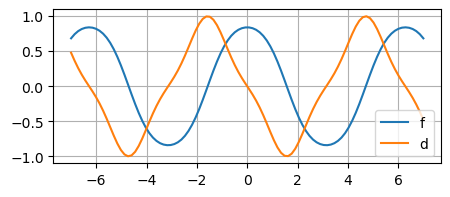

4.71238898038469


In [11]:
# Newton's method for finding zeros
def y(x):
    return sin(cos(x))

dual.plot(y, -7,7)

x = 4
x0 = 1.0e99
while abs(x-x0) > 1.0e-9:
    ydual = y(dual(x,1))
    x0 = x
    x = x - ydual.f/ydual.d
print(x)

[1, 0.6666666666666667]


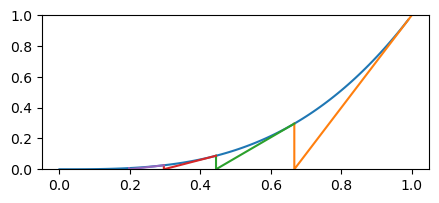

In [6]:
def y(x):
    return x**3

n=3
xp = np.arange(0,1,0.01)
plt.plot(xp, xp**n)
x0 = [1]
for i in range(1,5):
    x0.append(x0[i-1] - x0[i-1]/n)
print(x0[0:2])
plt.plot([x0[0], x0[1], x0[1]], [x0[0]**n, 0, x0[1]**n])
plt.plot([x0[1], x0[2], x0[2]], [x0[1]**n, 0, x0[2]**n])
plt.plot([x0[2], x0[3], x0[3]], [x0[2]**n, 0, x0[3]**n])
plt.plot([x0[3], x0[4], x0[4]], [x0[3]**n, 0, x0[4]**n])
plt.ylim(0,1)
plt.show()

In [7]:
# Related rates
def height(t):
    a = dual(np.pi/3*(1/2)**2, 0)
    v = dual(1,0) - exp(-t)
    return (v/a)**(1/3)

for time in range(1,30):
    print(height(dual(time,1)).print())

[1.3415610154462234, 0.2602524206112209]
[1.489222892664916, 0.07769655222958367]
[1.5368002999727695, 0.026840574028348108]
[1.5535828387432915, 0.00966191829246955]
[1.5596664820235653, 0.003526746394325806]
[1.5618926319754092, 0.0012937217359784547]
[1.5627099922714172, 0.0004754358945327159]
[1.5630104672962641, 0.00017483585049330396]
[1.5631209768182428, 6.430942091734251e-05]
[1.5631616270681787, 2.3656883379612778e-05]
[1.5631765809274654, 8.702714529124047e-06]
[1.563182082072877, 3.2015272239209462e-06]
[1.563184105821435, 1.1777729964594631e-06]
[1.5631848503156052, 4.332780590514953e-07]
[1.563185124199526, 1.593940343811949e-07]
[1.5631852249557656, 5.863778073513337e-08]
[1.5631852620219113, 2.157163298536412e-08]
[1.563185275657784, 7.935760149361823e-09]
[1.563185280674141, 2.9194029902807442e-09]
[1.5631852825195558, 1.073988338082929e-09]
[1.5631852831984459, 3.950982292954123e-10]
[1.5631852834481956, 1.453485157545781e-10]
[1.5631852835400735, 5.347073074460717e-11

S= [100.05807600940865, -0.5745855020409742]
H= [7.792472015742465, 0.00919665130152724]
P= [100.00924298872297, 0.2950764958920932]


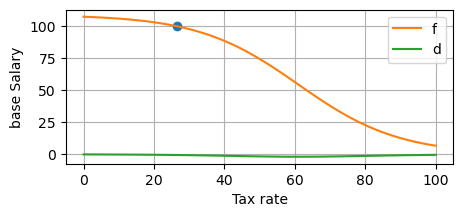

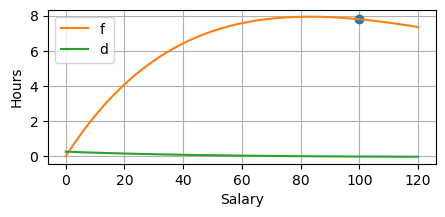

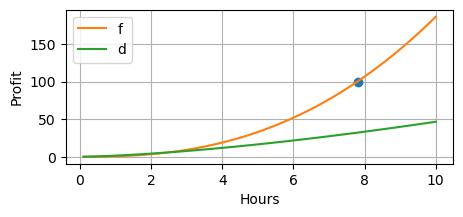

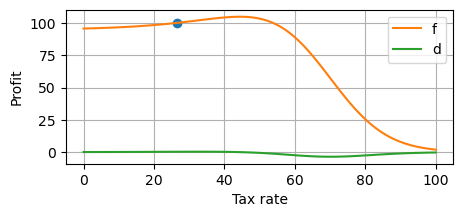

In [140]:
P = lambda h: dual(0.59,0)*h**2.5
H = lambda s: dual(0.26,0)*s*exp(-s/dual(83.0,0))
S = lambda t: dual(109,0)/(dual(1,0)+exp(dual(0.07,0)*(t-dual(61,0))))

T = dual(26.5,1)
print("S=", S(T).print())
print("H=", H(S(T)).print())
print("P=", P(H(S(T))).print())

plt.ylabel("base Salary");plt.xlabel("Tax rate"); 
plt.plot([26.5],[100], marker = 'o'); dual.plot(S,0,100)
plt.ylabel("Hours"); plt.xlabel("Salary"); 
plt.plot([100],[7.8], marker = 'o'); dual.plot(H,0, 120)
plt.ylabel("Profit"); plt.xlabel("Hours"); 
plt.plot([7.8],[100], marker = 'o'); dual.plot(P, 0.1, 10)
plt.ylabel("Profit"); plt.xlabel("Tax rate"); 
plt.plot([26.5],[100], marker = 'o'); dual.plot(lambda T:P(H(S(T))),0, 100)

[1.0655211322337126, -0.12701323243857365]


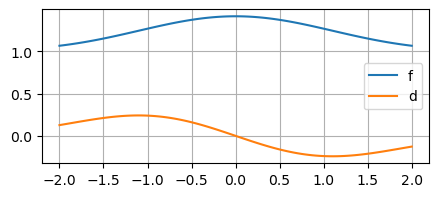

In [38]:
f = lambda x: sqrt( dual(1,0) + exp(-x**2/dual(2,0)) )
print(f(dual(2,1)).print())
dual.plot(f, -2,2)

In [44]:
#Exercise 7
x = dual(2,1)
w1 = x**2; print(w1.print())
w2 = dual(-1/2,0) * w1; print(w2.print())
w3 = exp(w2); print(w3.print())
w4 = dual(1,0) + w3; print(w3.print())
y = sqrt(w4); print(y.print())

[4, 4]
[-2.0, -2.0]
[0.1353352832366127, -0.2706705664732254]
[0.1353352832366127, -0.2706705664732254]
[1.0655211322337126, -0.12701323243857365]


In [49]:
0.5/np.sqrt(1.1353)*(-0.2707)

-0.12702901811661488

In [4]:
#multiply-nested function
def g(x,n):
    v = cos(x)
    for i in range(n-1):
        v = cos(v)
    return v
#print(g(np.pi, 1))

[0.7399877647958709, 0.01971165508115224]
[0.7071067811865476, -0.7071067811865476]


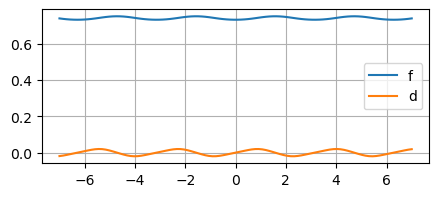

In [7]:
f = lambda x: g(x, 10)
a = dual(np.pi/4,1)
print(f(a).print())
print(cos(a).print())
dual.plot(f, -7, 7)

### def euler(q, dt):
    x0, y0, vx0, vy0 = q
    x = x0 + vx0*dt
    y = y0 + vy0*dt
    vx = vx0 - b*vx0 * dt
    vy = vy0 - (g + b*vy0)*dt
    return [x, y, vx, vy]

In [ ]:
def trajectory(target, theta):
    v0 = dual(9.8*math.sqrt(2),0)
    vx0 = theta.cos() * v0
    vy0 = theta.sin() * v0
    x0 = dual(0,0)
    y0 = dual(0,0)
    g = dual(9.8, 0)
    b = dual(0, 0)
    dt = dual(0.001, 0)
    q = [x0, y0, vx0, vy0]
    t=0
    while(q[1].print()[0] >= 0):
        #print("t = " + str(t))
        t+=dt.print()[0]
        #print (q[0].print()[0], q[1].print()[0])
        q = euler(q, dt)
#    print("t = " + str(t));
#    print ("(x,y) = ", "(", q[0].print()[0], ",", q[1].print()[0], ")")
    xe = q[0]
    f = (xe-target)**2
    return f

In [ ]:
target = dual(19.6, 0)
theta = dual(45 * pi/180, 1)
f = trajectory(target, theta).print()
print(f[0], "   ", f[1])

In [ ]:
target = dual(19.6, 0)
N = 20
for r in range(N):
    theta = dual(r/N * 85 * pi/180, 1)
    f = trajectory(target, theta)
    print(round(r/N * 85,1),"   ", f.f, "   ", f.d)

In [ ]:
theta.cos().print()

In [ ]:
for i in range(-10,10):
    x = dual(i*pi/4.0,1)
    f = x.sin()
    print(x.print()[0], "   ", f.print()[0], "     ", f.print()[1])

In [ ]:
dt = dual(0.002,0)
g = dual(9.8, 0)
v0 = dual(9.8*math.sqrt(2),0)
px = dual(0,0)
py = dual(0,0)
ptheta = dual(0,0)
for deg in range(35,55,1):
    theta = dual(deg * pi/180, 1)
    vx = theta.cos() * v0
    vy = theta.sin() * v0
    x = dual(0,0)
    y = dual(0,0)
    t = dual(0,0)
    while(vy.f > 0):
        t = t+dt
        x = x + vx*dt
        y = y + vy*dt
        vx = vx
        vy = vy - g*dt
        #print(y.f)
    print(round(theta.f,3), "x.f=", round(x.f,4), "x.d_num=", round((x.f-px.f)/(theta.f-ptheta.f),2), "x.d=", round(x.d,4), 
          "x.d_th=", round((v0**2/g*(dual(2,0)*theta).cos()).f,2), "    ", 
          "y.f=",round(y.f,4), "y.d_num=", round((y.f-py.f)/(theta.f-ptheta.f),4) ,"y.d=",round(y.d,4),"  ", (vx*t).f, (vx*t).d)
    px = x
    py = y
    ptheta = theta

In [ ]:
v0.print()